In [1]:
import plot_functions
import compare_clusterings
import process_data
import visualizations

from compare_clusterings import *
from process_data import *
from plot_functions import *
from visualizations import *

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import mpl_toolkits.mplot3d.axes3d as p3
import matplotlib.animation as animation

In [3]:
import traj_generator
import physics_sim_simple_moreparticles_proteins

import process_data

In [4]:
import numpy as np
import plotly.graph_objs as go

In [5]:
move_groups_nr = 3
particles_per_group = 100

explicit_groups = []
group_size = 10

curr_group = 0
while 1 == 1:
    for i in range(group_size):
        explicit_groups.append(curr_group%move_groups_nr)

        if len(explicit_groups) == particles_per_group:
            break
    if len(explicit_groups) == particles_per_group:
        break
    curr_group = curr_group + 1


In [6]:
explicit_groups

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0]

In [7]:
sim_command = "physics_sim_simple_moreparticles_proteins.simulate_for_clustering(stim_steps=1000, temp=[1,2,3], thermostat=1, entities=1, particles_per_group=100, group_thermostat=1, dt=0.01, harmpot=0, fenepot=1, desireddist = 1.04, pot_const=30, group_additions=True, friction=1, explicit_groups=explicit_groups)"
particles_from_sim = eval(sim_command)

In [8]:
#particles_from_sim = physics_sim_simple_moreparticles_proteins.simulate_for_clustering(stim_steps=1000, temp=[1,2,3], thermostat=1, entities=1, particles_per_group=100, group_thermostat=1, dt=0.01, harmpot=0, fenepot=1, desireddist = 1.04, pot_const=30, group_additions=True, friction=1, explicit_groups=explicit_groups)

In [9]:
#particles_from_sim = physics_sim_simple_moreparticles_proteins.simulate_for_clustering(stim_steps=1000, temp=[1,2,3], thermostat=1, entities=1, particles_per_group=100, group_thermostat=0, dt=0.01, harmpot=0, fenepot=1, desireddist = 1.04, pot_const=30, group_additions=True, friction=1, explicit_groups=explicit_groups)

In [10]:
trajectories = process_data.simulation_to_array(particles_from_sim)

In [11]:
plot_functions.plot_traj_labels_plotly_2nd(trajectories)

In [12]:
groups_list = np.array(trajectories)[:,:,-1]
num_groups = len(np.unique(np.array(groups_list).flatten()))

In [13]:
num_groups

3

In [14]:
%matplotlib notebook


a = plot_functions.plot_traj_labels_plt(trajectories, save_video=False, interval = 10, title = sim_command + "\n Ground Truth", plt_fig_size=(10,7.5))

<IPython.core.display.Javascript object>

In [15]:
a

In [16]:
plt.show()

In [17]:
from IPython.display import HTML
HTML(a.to_html5_video())

In [18]:
df = process_data.create_clustering_df(trajectories)

In [19]:
import redpandda_general
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan")

0.0255


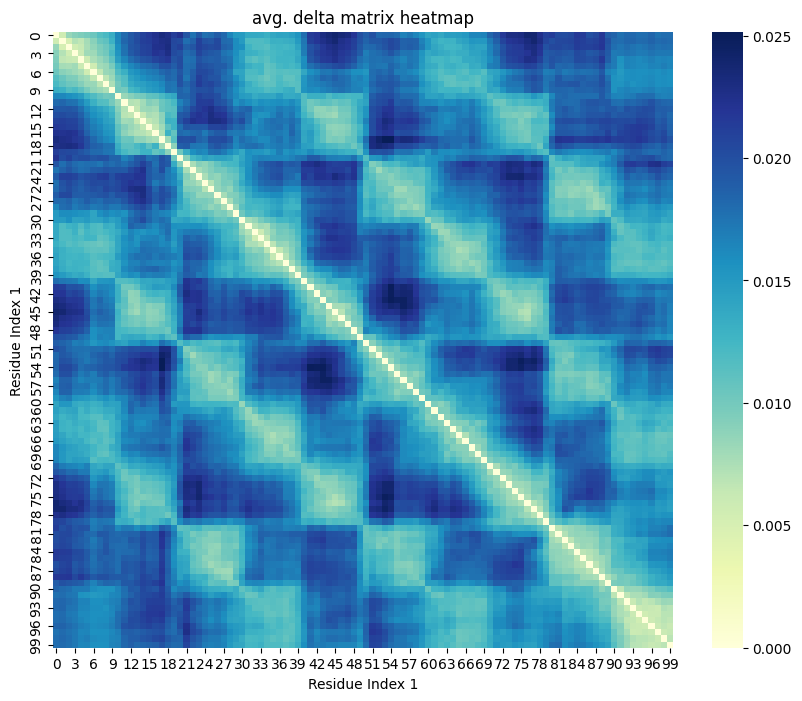

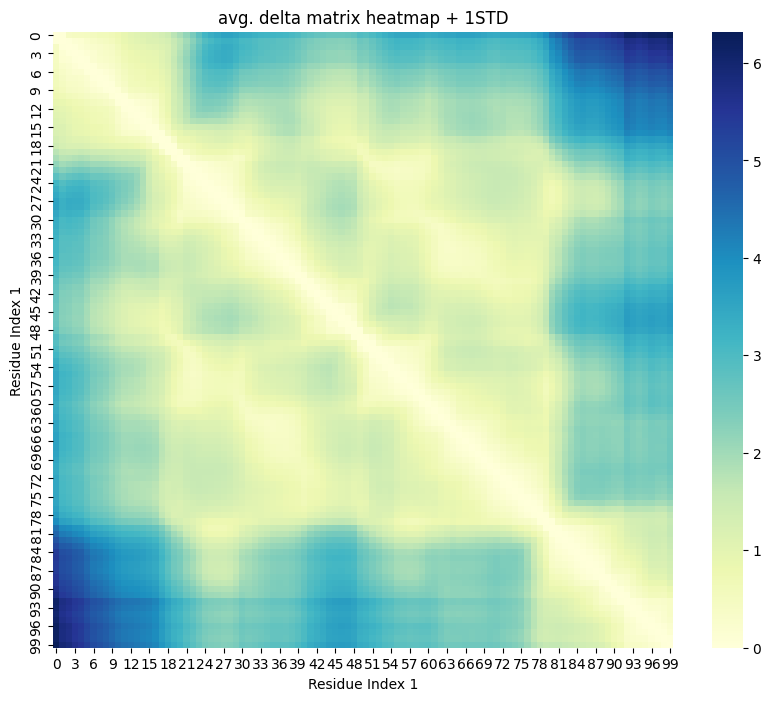

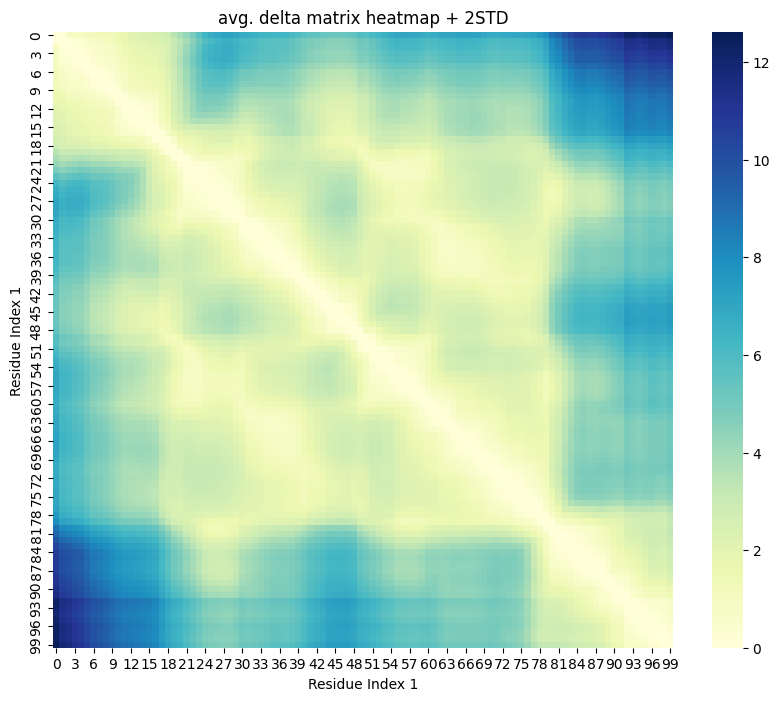

2.0046
something wrong with clustering Q computation


In [20]:
%matplotlib inline

res_hdbscan_2std = redpandda_general.main_clustering_general_std(df, None, clustering_algorithm="hdbscan")

In [21]:
res_hdbscan_2std

(array([-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1]),
 [],
 array([[1.        , 0.9965236 , 0.93540393, ..., 0.01995359, 0.02155853,
         0.        ],
        [0.9965236 , 1.        , 0.99620878, ..., 0.08230004, 0.08288954,
         0.06057693],
        [0.93540393, 0.99620878, 1.        , ..., 0.09831309, 0.09946698,
         0.07820631],
        ...,
        [0.01995359, 0.08230004, 0.09831309, ..., 1.        , 0.99615438,
         0.97521274],
        [0.02155853, 0.08288954, 0.09946698, ..., 0.99615438, 1.        ,
         0.99581352],
        [0.        , 0.06057693, 0.07820631, ..., 0.

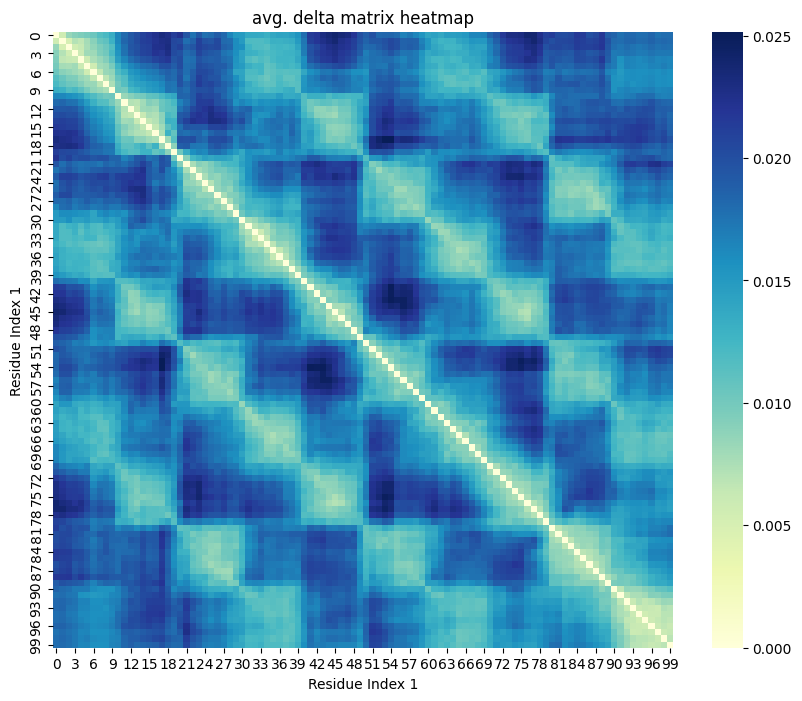

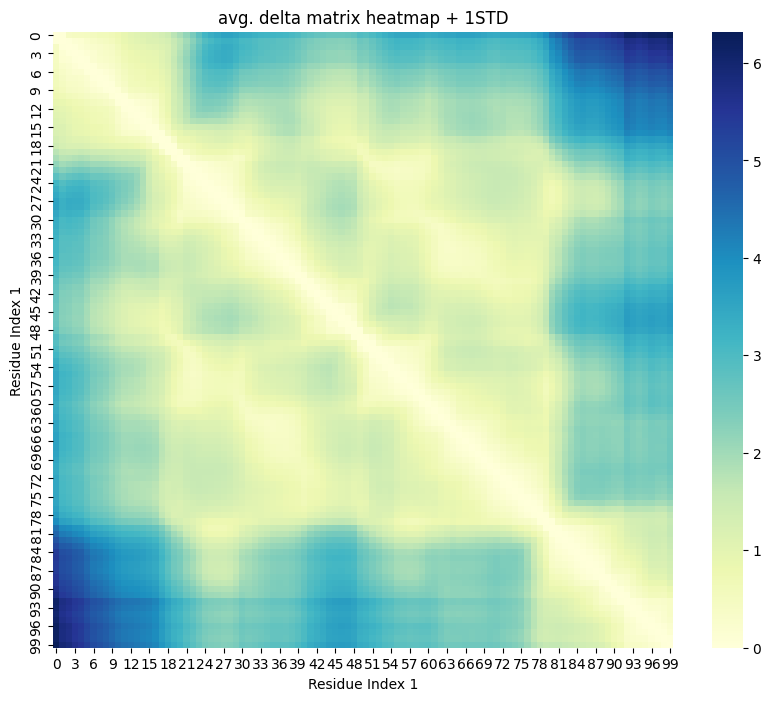

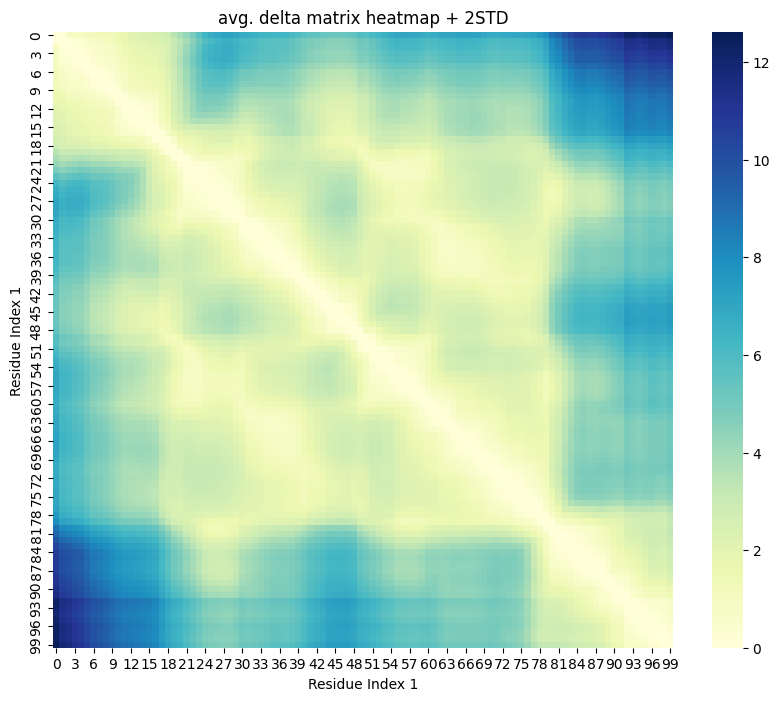

1.8996
something wrong with clustering Q computation


In [22]:
res_specvar = redpandda_general.main_clustering_general_std(df, None)

In [23]:
import redpandda_general
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan")

0.0050


In [24]:
res_hdbscan

(array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 3, 3,
        3, 3, 3, 3, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 4,
        4, 4, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
 5.343363012606549,
 array([[0.99959443, 0.99968625, 0.99972991, ..., 0.99987918, 0.99988331,
         0.99988297],
        [0.99968625, 0.99959443, 0.9996753 , ..., 0.99988477, 0.99988904,
         0.99988481],
        [0.99972991, 0.9996753 , 0.99959443, ..., 0.99987837, 0.99988125,
         0.99988099],
        ...,
        [0.99987918, 0.99988477, 0.99987837, ..., 0.99959443, 0.99969167,
         0.99969882],
        [0.99988331, 0.99988904, 0.99988125, ..., 0.99969167, 0.99959443,
         0.99970405],
        [0.99988297, 0.99988481, 0.99988099, ..., 0.99969882, 0.99970405,
         0.99959443]]),
 [array([[ 0],
         [ 1],
         [ 2],
  

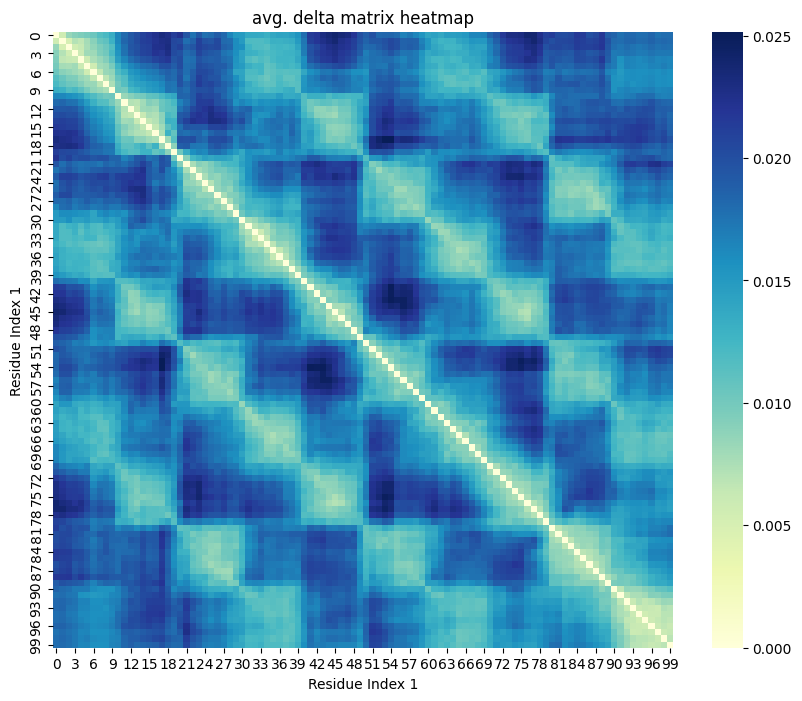

0.5306
something wrong with clustering Q computation


In [25]:
res = redpandda_general.main_clustering_general(df, 2)

In [26]:
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan", min_cluster_size=2, min_samples=1)

0.0084


In [27]:
res_hdbscan

(array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 3, 3,
        3, 3, 3, 3, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 4,
        4, 4, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
 5.343363012606549,
 array([[0.99959443, 0.99968625, 0.99972991, ..., 0.99987918, 0.99988331,
         0.99988297],
        [0.99968625, 0.99959443, 0.9996753 , ..., 0.99988477, 0.99988904,
         0.99988481],
        [0.99972991, 0.9996753 , 0.99959443, ..., 0.99987837, 0.99988125,
         0.99988099],
        ...,
        [0.99987918, 0.99988477, 0.99987837, ..., 0.99959443, 0.99969167,
         0.99969882],
        [0.99988331, 0.99988904, 0.99988125, ..., 0.99969167, 0.99959443,
         0.99970405],
        [0.99988297, 0.99988481, 0.99988099, ..., 0.99969882, 0.99970405,
         0.99959443]]),
 [array([[ 0],
         [ 1],
         [ 2],
  

In [28]:
res

(array([0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]),
 [],
 [],
 [array([[ 0],
         [ 1],
         [ 2],
         [ 3],
         [ 4],
         [ 5],
         [ 6],
         [ 7],
         [ 8],
         [ 9],
         [10],
         [11],
         [12],
         [13],
         [14],
         [15],
         [16],
         [17],
         [18],
         [19],
         [20],
         [21],
         [22],
         [23],
         [24],
         [25],
         [26],
         [27],
         [28],
         [29],
         [30],
         [31],
         [32],
         [33],
         [34],
         [35],
         [36],
         [37],
         [38],
         [39],
         [40],
         [41],
         [42],
   

In [29]:
res_agglon = redpandda_general.main_clustering_general(df, None, clustering_algorithm="agglomerative")

something wrong with clustering Q computation


In [30]:
res_agglon

(array([61, 99, 98, 94, 78, 97, 96, 88, 95, 58, 87, 80, 70, 92, 50, 91, 90,
        59, 81, 63, 45, 71, 93, 53, 79, 89, 65, 68, 64, 39, 67, 69, 47, 34,
        73, 44, 66, 32, 60, 74, 29, 51, 83, 77, 31, 82, 54, 43, 49, 48, 33,
        62, 52, 26, 72, 55, 30, 46, 40, 56, 23, 35, 57, 85, 24, 36, 84, 28,
        75, 76, 15, 19, 16, 21, 17, 37, 38, 27, 14, 11, 41, 13, 86, 18, 42,
        25, 20,  7,  8,  3, 12, 22,  6,  5,  2,  9, 10,  4,  1,  0]),
 [],
 array([[0.        , 0.22639134, 0.33404745, ..., 0.70208926, 0.71229172,
         0.71143861],
        [0.22639134, 0.        , 0.19938806, ..., 0.71586866, 0.72639803,
         0.71596892],
        [0.33404745, 0.19938806, 0.        , ..., 0.70010137, 0.70720579,
         0.70655184],
        ...,
        [0.70208926, 0.71586866, 0.70010137, ..., 0.        , 0.23976323,
         0.25738757],
        [0.71229172, 0.72639803, 0.70720579, ..., 0.23976323, 0.        ,
         0.27029258],
        [0.71143861, 0.71596892, 0.70655184, ..., 0.

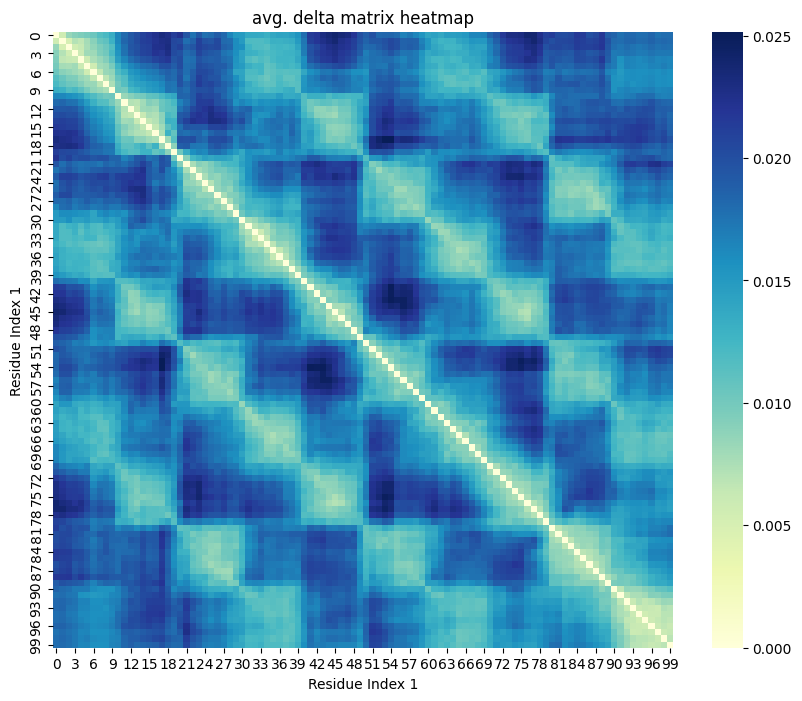

0.6171


In [31]:
res = redpandda_general.main_clustering_general(df, 6)

In [32]:
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan")

0.0149


In [33]:
res_hdbscan

(array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 3, 3,
        3, 3, 3, 3, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 4,
        4, 4, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
 5.343363012606549,
 array([[0.99959443, 0.99968625, 0.99972991, ..., 0.99987918, 0.99988331,
         0.99988297],
        [0.99968625, 0.99959443, 0.9996753 , ..., 0.99988477, 0.99988904,
         0.99988481],
        [0.99972991, 0.9996753 , 0.99959443, ..., 0.99987837, 0.99988125,
         0.99988099],
        ...,
        [0.99987918, 0.99988477, 0.99987837, ..., 0.99959443, 0.99969167,
         0.99969882],
        [0.99988331, 0.99988904, 0.99988125, ..., 0.99969167, 0.99959443,
         0.99970405],
        [0.99988297, 0.99988481, 0.99988099, ..., 0.99969882, 0.99970405,
         0.99959443]]),
 [array([[ 0],
         [ 1],
         [ 2],
  

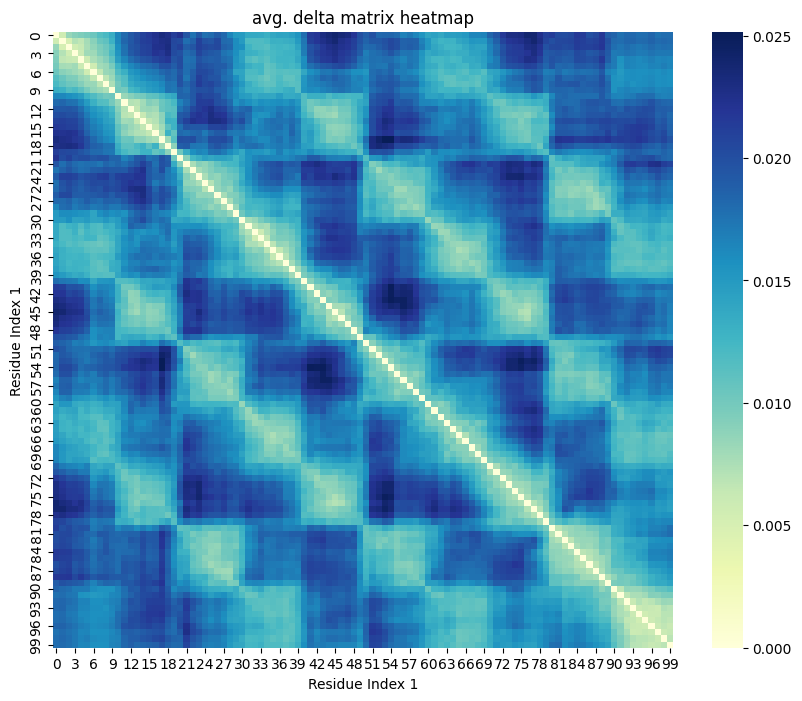

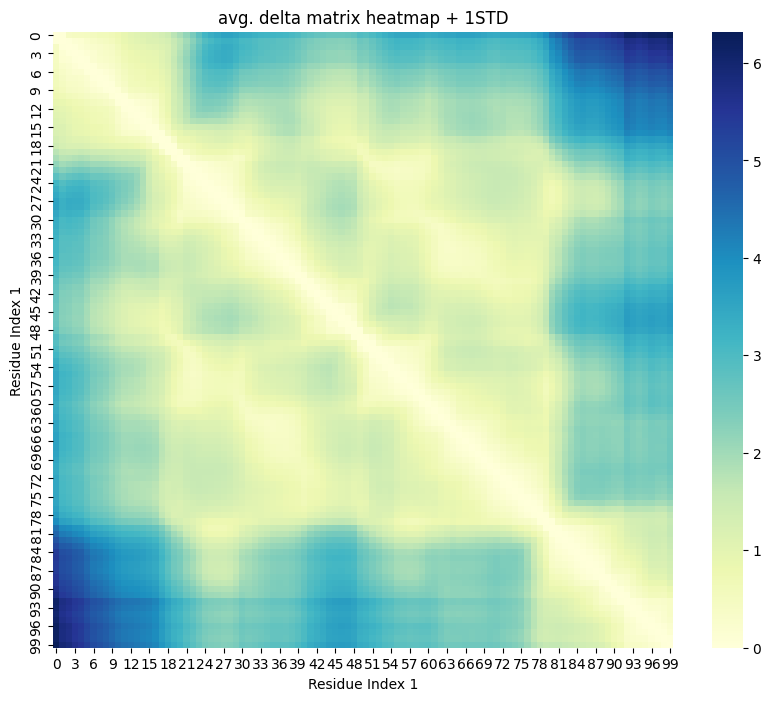

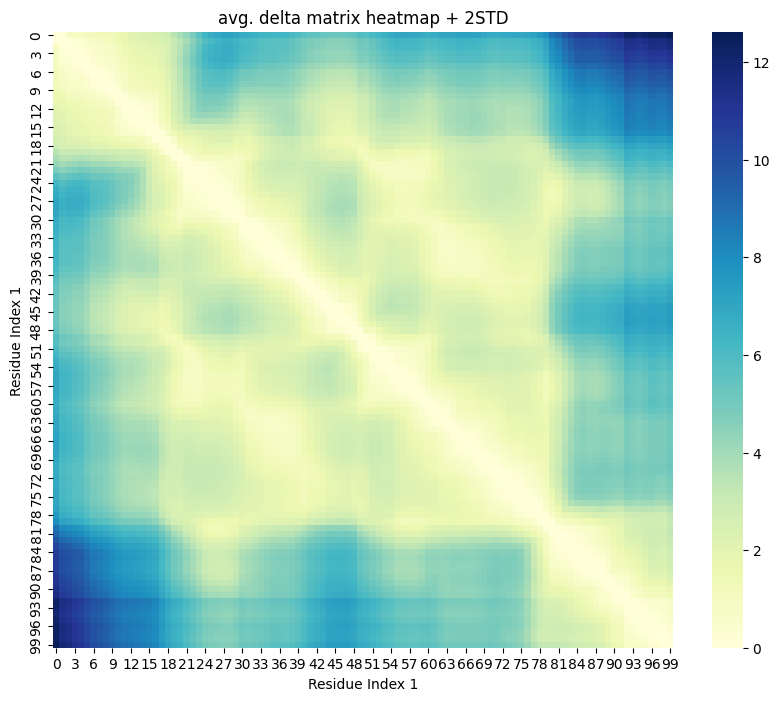

1.7530
something wrong with clustering Q computation


In [34]:
res_specvar = redpandda_general.main_clustering_general_std(df, None)

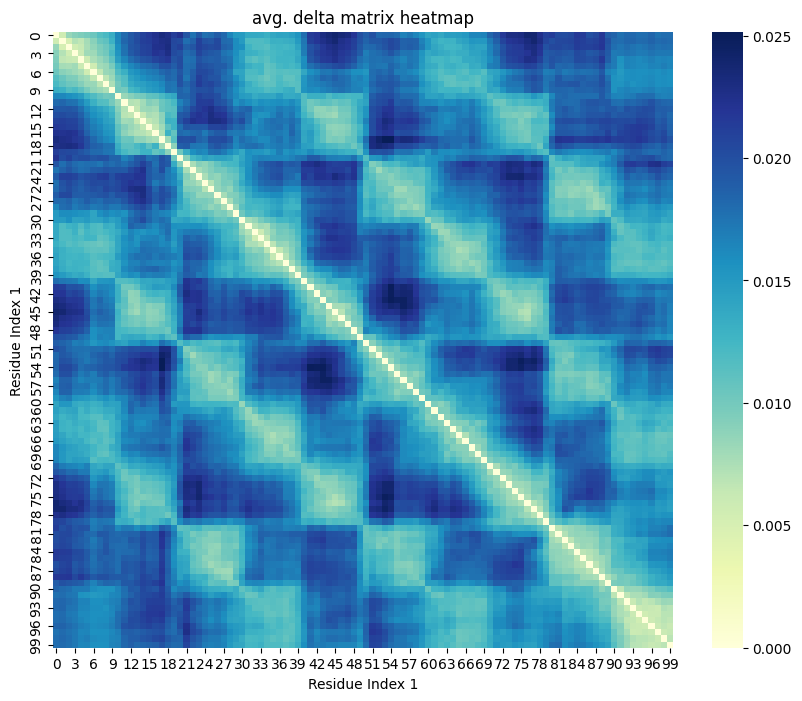

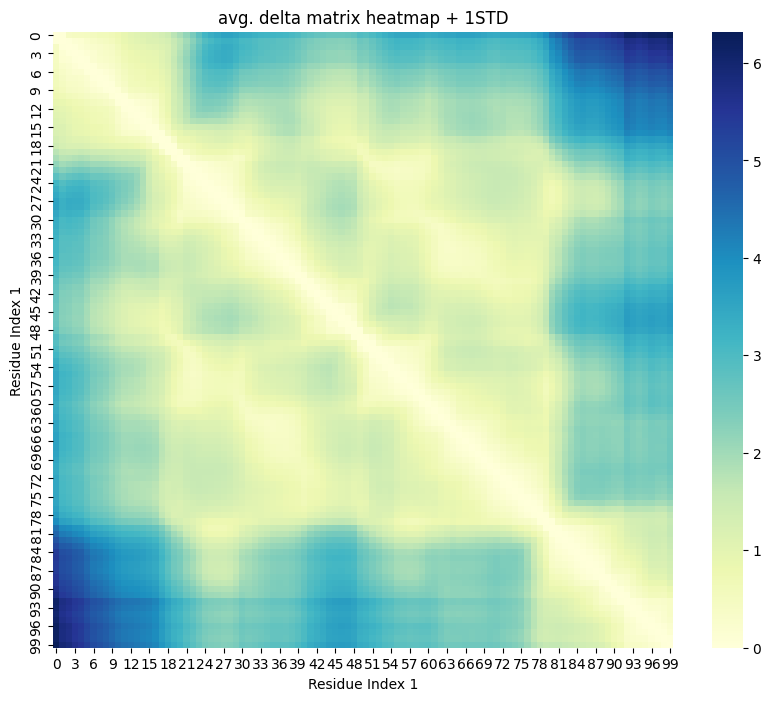

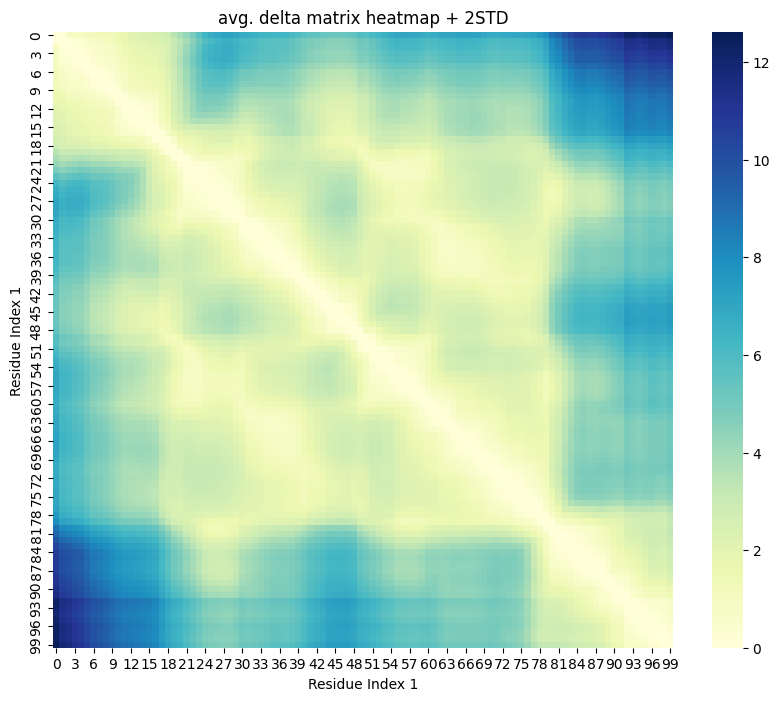

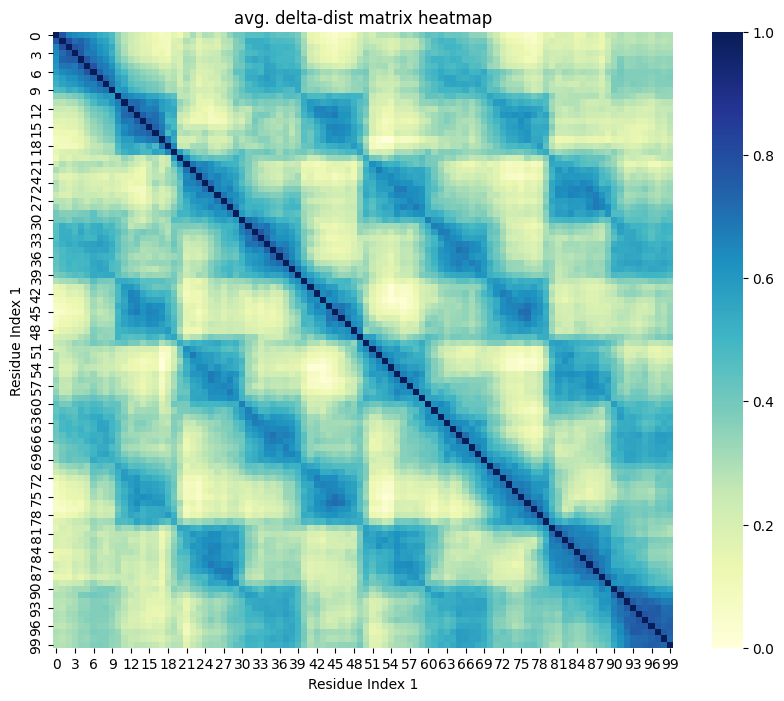

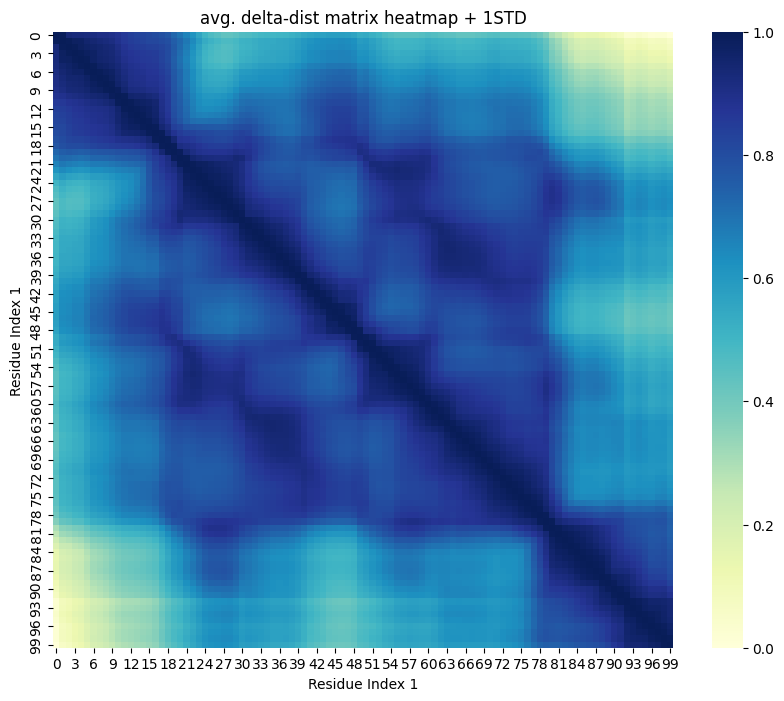

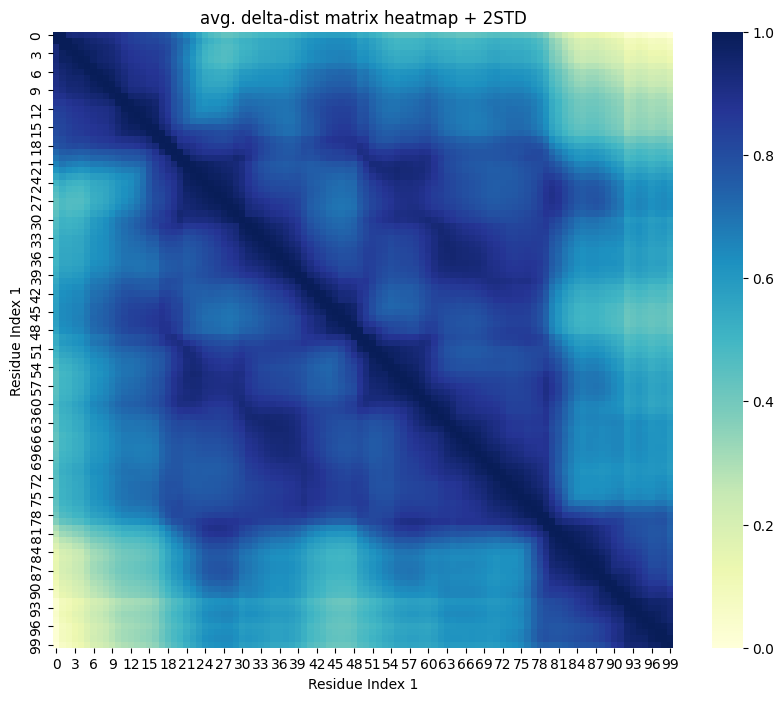

3.7627


In [35]:
res_specvar_distance = redpandda_general.main_clustering_general_std_distance(df, None)

In [36]:
result_labels = res[0]

In [37]:
result_labels

array([3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2,
       2, 2, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 4, 4, 4, 4, 4, 4, 4,
       4, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 5, 5, 5, 5, 5, 5, 5, 5,
       5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [38]:
trajectories_results = []
for ip, particle_traj in enumerate(trajectories):
    trajectory_result = []

    for it, timestep in enumerate(particle_traj):
        trajectory_result.append([*timestep[:-1], result_labels[ip]])
    trajectories_results.append(trajectory_result)

In [39]:
trajectories_results = [
    [[*timestep[:-1], result_labels[ip]] for timestep in particle_traj]
    for ip, particle_traj in enumerate(trajectories)
]

In [40]:
traj_array, point_array, frames_count, n_objects = redpandda_general.prepare_data_from_df(df)

In [41]:
dist_matrices = redpandda_general.get_distance_matrices(traj_array)
delta_matrices = redpandda_general.get_delta_matrices(dist_matrices)
average_delta_matrix = redpandda_general.calculate_average_delta_matrix(delta_matrices)

std_delta_matrix = redpandda_general.get_std_matrices(dist_matrices)

In [42]:
std_delta_matrix

array([[0.        , 0.01909266, 0.40347579, ..., 6.17641715, 6.16615973,
        6.3022302 ],
       [0.01909266, 0.        , 0.02141919, ..., 5.78276424, 5.77891137,
        5.91986143],
       [0.40347579, 0.02141919, 0.        , ..., 5.68190137, 5.67452956,
        5.8087177 ],
       ...,
       [6.17641715, 5.78276424, 5.68190137, ..., 0.        , 0.02125473,
        0.15319944],
       [6.16615973, 5.77891137, 5.67452956, ..., 0.02125473, 0.        ,
        0.02302192],
       [6.3022302 , 5.91986143, 5.8087177 , ..., 0.15319944, 0.02302192,
        0.        ]])

In [43]:
summed_delta_matrix = average_delta_matrix

In [44]:
summed_delta_matrix_1std = summed_delta_matrix + std_delta_matrix 
summed_delta_matrix_2std = summed_delta_matrix + std_delta_matrix * 2

In [45]:
from distance_matrix import *

In [46]:
normed_delta_matrix = 1 - normed_values(summed_delta_matrix)
normed_delta_matrix_1std = 1 - normed_values(summed_delta_matrix_1std)
normed_delta_matrix_2std = 1 - normed_values(summed_delta_matrix_2std)

In [47]:
normed_similarity_matrix = 1 - normed_values(summed_delta_matrix)
normed_similarity_matrix_1std = 1 - normed_values(summed_delta_matrix_1std)
normed_similarity_matrix_2std = 1 - normed_values(summed_delta_matrix_2std)

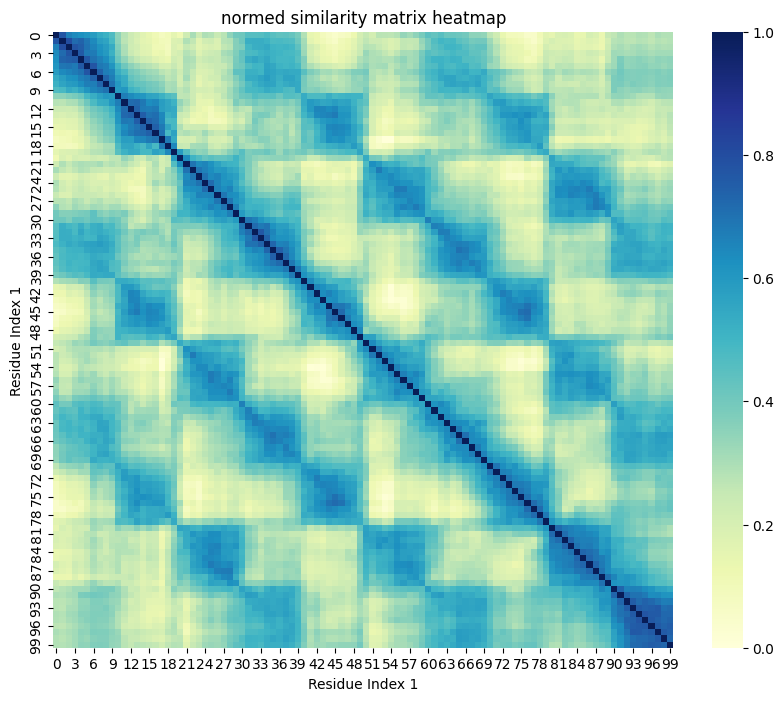

In [48]:
create_delta_heatmap(normed_similarity_matrix, title="normed similarity matrix heatmap")

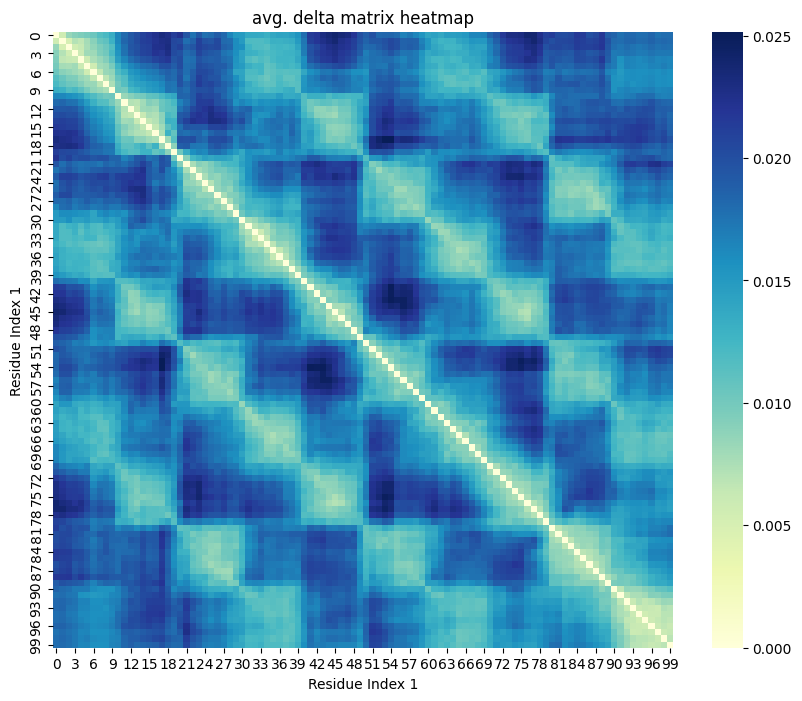

In [49]:
import distance_matrix
distance_matrix.create_delta_heatmap(average_delta_matrix, title="avg. delta matrix heatmap")

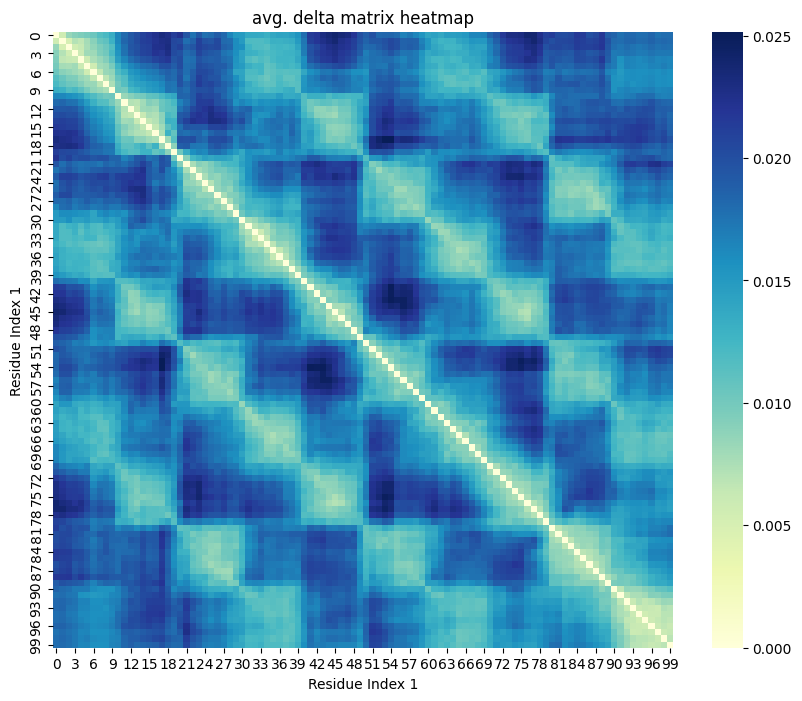

0.5482


array([4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 5, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 2, 2, 2, 2,
       2, 2, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3,
       3, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [50]:
spectral_clustering_on_deltas(average_delta_matrix, 6)

In [51]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result = clustering.fit(normed_similarity_matrix)

In [52]:
result.labels_

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 1, 1, 1, 1,
       1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 5, 5, 5, 5, 5,
       5, 5, 5, 5, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5], dtype=int32)

In [53]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result = clustering.fit(summed_delta_matrix_2std)
print(result.labels_)

[3 3 3 3 1 1 1 1 1 1 1 1 1 1 1 4 3 5 5 2 5 2 1 1 1 1 4 4 4 4 4 3 3 1 1 1 1
 1 1 1 3 3 3 3 3 3 1 1 1 1 4 4 4 4 4 3 3 3 3 3 3 0 4 4 4 4 4 4 4 1 1 1 1 1
 0 0 0 4 4 1 1 1 1 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1]


In [54]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 

result = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result.labels_)

[ 0  0  0  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1 -1 -1  3  3  3
  3  3  3  3  3 -1  2  2  2  2  2  2  2  2  2 -1 -1  1  1  1  1  1  1  1
 -1 -1 -1 -1  3  3  3  3  3  3 -1 -1  2 -1  2  2  2  2  2  2  2  1  1  1
  1  1  1  1  1  1  1 -1  3  3  3  3  3  3  3  3  3 -1  4  4  4  4  4  4
  4  4  4  4]


In [55]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix_1std.astype(np.float64))

print(result.labels_)

[-1  0  0  0  0  0  0  0  0  0 -1  2  2  2  2  2  2  2  2  3  3  3  3  3
  3  3  3  3 -1 -1 -1  4  4  4  4  4  4  4  4  4 -1 -1  6  6  6  6  6  6
  6  6  6  7  7  7  7  7  7 -1 -1 -1 -1 -1 -1 -1 -1  1  1  1  1 -1 -1 -1
 -1  8  8  8  8  8  8  9  9  9  9  9  9  9  9  9  9 -1 -1  5  5  5  5  5
  5  5  5 -1]


In [56]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix_2std.astype(np.float64))

print(result.labels_)

[-1  0  0  0  0  0  0  0  0  0  0  2  2  2  2  2  2  2  2  3  3  3  3  3
  3  3  3  3 -1 -1 -1  5  5  5  5  5  5  6  6  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4 -1 -1 -1 -1 -1 -1 -1  1  1  1  1  1 -1 -1
  8  8  8  8  8  8  8  8  8  8  8  8  8  8  8  8  8  9  9  7  7  7  7  7
  7  7  7 -1]


In [57]:
normed_delta_matrix = normed_values(summed_delta_matrix)
normed_delta_matrix_1std = normed_values(summed_delta_matrix_1std)
normed_delta_matrix_2std =  normed_values(summed_delta_matrix_2std)

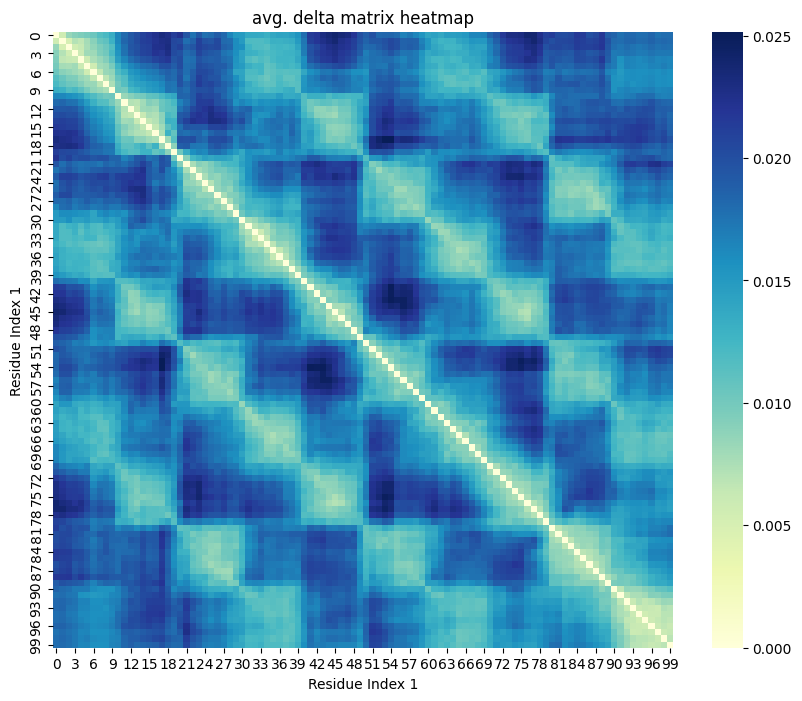

0.6230


array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 3, 1, 1, 1, 1,
       5, 5, 5, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2])

In [58]:
spectral_clustering_on_deltas(average_delta_matrix, 6)

In [59]:
clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.1, affinity='precomputed', linkage='complete')

result = clustering.fit(average_delta_matrix)

In [60]:

clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.7, metric='precomputed', linkage='complete')

result = clustering.fit(summed_delta_matrix_2std)

In [61]:
result.labels_

array([23, 23, 12, 12, 12, 12,  0,  0,  0,  0,  0,  1,  1,  1,  1,  1,  1,
        2,  2,  2, 20, 20,  6,  6,  6,  6,  6,  6, 24, 24, 11, 11, 11, 11,
       21, 21, 21, 17, 17, 17,  7,  7,  7, 26, 26,  9,  9,  9, 16, 16, 19,
       28, 28, 28, 13, 13, 13, 13, 25, 25, 10, 10, 10,  3,  3,  3,  3,  3,
       14, 14, 14, 14, 18, 18, 18, 18, 29, 29, 15, 15,  4,  4,  4,  4,  4,
       22, 22, 22,  5,  5,  5,  5, 27, 27, 27, 27,  8,  8,  8,  8])

In [62]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix_2std.astype(np.float64))

print(result.labels_)

[-1  0  0  0  0  0  0  0  0  0  0  2  2  2  2  2  2  2  2  3  3  3  3  3
  3  3  3  3 -1 -1 -1  5  5  5  5  5  5  6  6  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4 -1 -1 -1 -1 -1 -1 -1  1  1  1  1  1 -1 -1
  8  8  8  8  8  8  8  8  8  8  8  8  8  8  8  8  8  9  9  7  7  7  7  7
  7  7  7 -1]


In [63]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result.labels_)

[ 1  1  1  1  1  1  1  1  1  1  3  3  3  3  3  3  3  3  3  0  0 -1  8  8
  8  8 -1  7  7 -1  4  4  4  4  4  4  4  4  4  2  2  3  3  3  3  3  3  3
 -1 -1 -1 -1  8 -1 -1  6  6 -1 -1 -1  4 -1  4  4  4  4  4  4  4  3  3  3
  3  3  3  3  3  3  3 -1  7  7  7  7  7  7  7  7  7 -1  5  5  5  5  5  5
  5  5  5  5]


In [64]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(normed_delta_matrix_2std.astype(np.float64))

print(result.labels_)

[-1  0  0  0  0  0  0  0  0  0  0  2  2  2  2  2  2  2  2  3  3  3  3  3
  3  3  3  3 -1 -1 -1  5  5  5  5  5  5  6  6  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4 -1 -1 -1 -1 -1 -1 -1  1  1  1  1  1 -1 -1
  8  8  8  8  8  8  8  8  8  8  8  8  8  8  8  8  8  9  9  7  7  7  7  7
  7  7  7 -1]


In [65]:
#FF

In [66]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result_spectral_6 = clustering.fit(normed_similarity_matrix)

clustering = SpectralClustering(n_clusters=3, affinity='precomputed')
result_spectral_3 = clustering.fit(normed_similarity_matrix)

In [67]:
clustering = SpectralClustering(n_clusters=4, affinity='precomputed')
result_spectral_4 = clustering.fit(normed_similarity_matrix)

In [68]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed', assign_labels="discretize")
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)

In [69]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed', assign_labels="discretize")
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)
result_spectral_6_discr.labels_

array([5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0,
       4, 4, 4, 4, 4, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3])

In [70]:
clustering = SpectralClustering(n_clusters=3, affinity='precomputed', assign_labels="discretize")
result_spectral_3_discr = clustering.fit(normed_similarity_matrix)
result_spectral_3_discr.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [71]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed', assign_labels="cluster_qr")
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)
result_spectral_6_discr.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 1, 2, 5, 5, 5, 1, 3, 3, 3, 3,
       1, 1, 1, 1, 1, 1, 4, 4, 4, 1, 1, 4, 4, 4, 4, 1, 1, 3, 3, 3, 3, 5,
       5, 5, 5, 5, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5])

In [72]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)
result_spectral_6_discr.labels_

array([5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1,
       1, 1, 4, 4, 4, 4, 2, 4, 4, 4, 4, 4, 2, 4, 4, 4, 4, 4, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3], dtype=int32)

In [73]:
result_spectral_3.labels_

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], dtype=int32)

In [74]:
result_spectral_6.labels_

array([5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2,
       2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 1, 1, 1, 1,
       1, 4, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4], dtype=int32)

In [75]:
result_spectral_6_discr.labels_

array([5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1,
       1, 1, 4, 4, 4, 4, 2, 4, 4, 4, 4, 4, 2, 4, 4, 4, 4, 4, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3], dtype=int32)

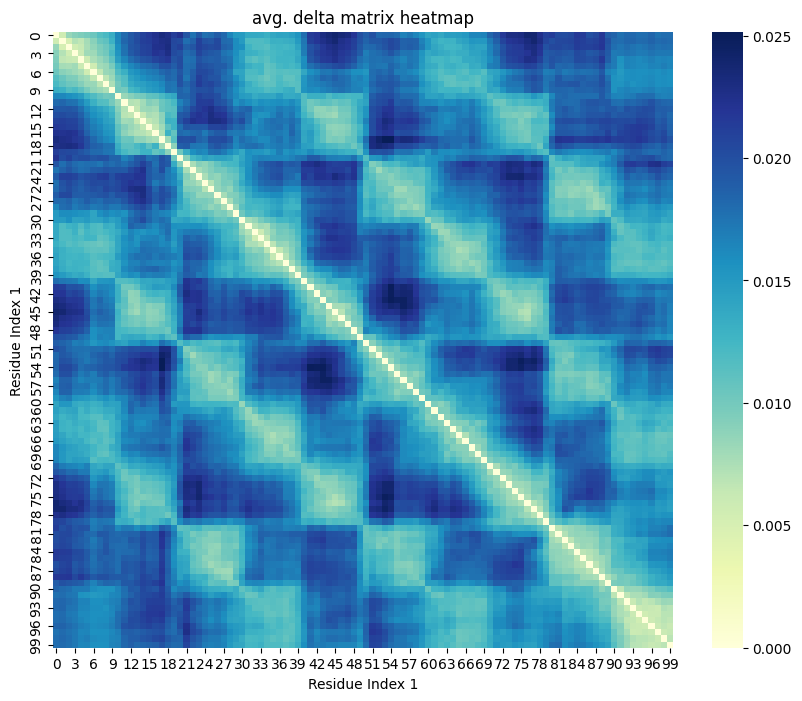

1.0288


array([3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2,
       2, 2, 2, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 5, 5, 1, 1, 1, 1, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [76]:
distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix, 6)

In [77]:
normed_similarity_matrix = 1 - normed_values(summed_delta_matrix)


In [78]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result = clustering.fit(summed_delta_matrix_2std)
print(result.labels_)

[1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 3 1 4 4 5 4 5 0 0 0 0 0 3 3 3 3 1 1 0 0 0 0
 0 0 1 1 1 1 1 1 0 0 0 0 0 3 3 3 3 3 1 1 1 1 1 1 0 3 3 3 3 3 3 3 0 0 0 0 0
 0 0 0 0 3 2 2 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


In [79]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 

result_hdbscan_4_2 = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result_hdbscan_4_2.labels_)

[ 0  0  0  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1 -1 -1  3  3  3
  3  3  3  3  3 -1  2  2  2  2  2  2  2  2  2 -1 -1  1  1  1  1  1  1  1
 -1 -1 -1 -1  3  3  3  3  3  3 -1 -1  2 -1  2  2  2  2  2  2  2  1  1  1
  1  1  1  1  1  1  1 -1  3  3  3  3  3  3  3  3  3 -1  4  4  4  4  4  4
  4  4  4  4]


In [80]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 


result_hdbscan_4_2_1std = clustering.fit(summed_delta_matrix_1std.astype(np.float64))

print(result_hdbscan_4_2_1std.labels_)

[-1  0  0  0  0  0  0  0  0  0 -1  2  2  2  2  2  2  2  2  3  3  3  3  3
  3  3  3  3 -1 -1 -1  4  4  4  4  4  4  4  4  4 -1 -1  6  6  6  6  6  6
  6  6  6  7  7  7  7  7  7 -1 -1 -1 -1 -1 -1 -1 -1  1  1  1  1 -1 -1 -1
 -1  8  8  8  8  8  8  9  9  9  9  9  9  9  9  9  9 -1 -1  5  5  5  5  5
  5  5  5 -1]


In [81]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result_hdbscan_2_2_2std = clustering.fit(summed_delta_matrix_2std.astype(np.float64))

print(result_hdbscan_2_2_2std.labels_)

[-1  0  0  0  0  0  0  0  0  0  0  2  2  2  2  2  2  2  2  3  3  3  3  3
  3  3  3  3 -1 -1 -1  5  5  5  5  5  5  6  6  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4  4  4 -1 -1 -1 -1 -1 -1 -1  1  1  1  1  1 -1 -1
  8  8  8  8  8  8  8  8  8  8  8  8  8  8  8  8  8  9  9  7  7  7  7  7
  7  7  7 -1]


In [82]:
normed_delta_matrix = normed_values(summed_delta_matrix)
normed_delta_matrix_1std = normed_values(summed_delta_matrix_1std)
normed_delta_matrix_2std =  normed_values(summed_delta_matrix_2std)

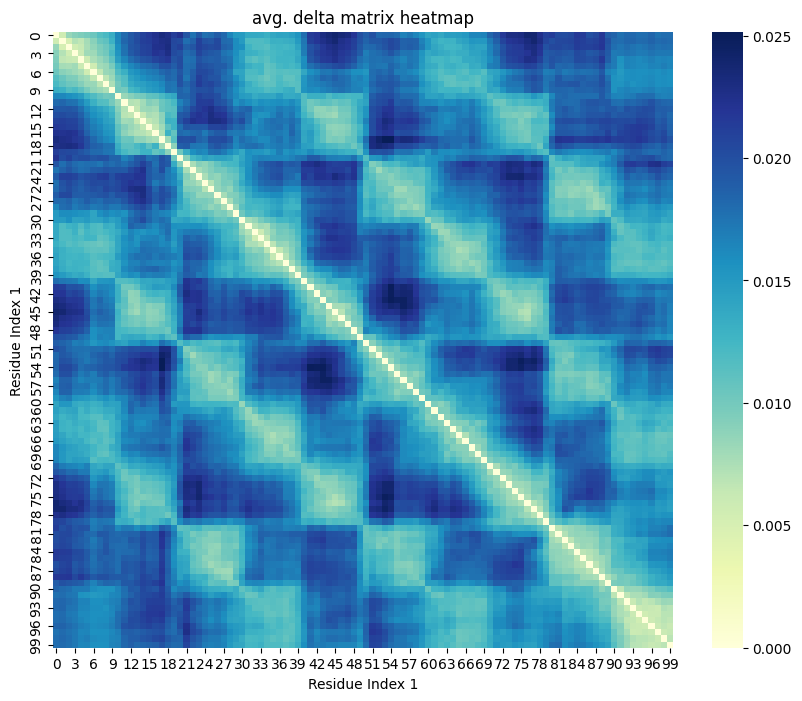

0.6327


array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2,
       2, 2, 5, 5, 5, 5, 1, 5, 1, 5, 5, 1, 1, 1, 1, 5, 5, 5, 5, 3, 3, 4,
       4, 4, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4])

In [83]:
spectral_clustering_on_deltas(average_delta_matrix, 6)

In [84]:
clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.1, affinity='precomputed', linkage='complete')

result_agglo_compl_dt01 = clustering.fit(average_delta_matrix)

In [85]:

clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.7, metric='precomputed', linkage='complete')

result_agglo_compl_dt07_2std  = clustering.fit(summed_delta_matrix_2std)

In [86]:

clustering = AgglomerativeClustering(n_clusters=3, metric='precomputed', linkage='complete')

result_agglo_cl3  = clustering.fit(average_delta_matrix)

In [87]:
result_agglo_compl_dt01.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [88]:
result_agglo_cl3.labels_

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2])

In [89]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result_hdbscan_2_2 = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result_hdbscan_2_2.labels_)

[ 1  1  1  1  1  1  1  1  1  1  3  3  3  3  3  3  3  3  3  0  0 -1  8  8
  8  8 -1  7  7 -1  4  4  4  4  4  4  4  4  4  2  2  3  3  3  3  3  3  3
 -1 -1 -1 -1  8 -1 -1  6  6 -1 -1 -1  4 -1  4  4  4  4  4  4  4  3  3  3
  3  3  3  3  3  3  3 -1  7  7  7  7  7  7  7  7  7 -1  5  5  5  5  5  5
  5  5  5  5]


In [90]:
result_hdbscan_2_2_2std.labels_

array([-1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  2,  2,  2,  2,  2,  2,
        2,  2,  3,  3,  3,  3,  3,  3,  3,  3,  3, -1, -1, -1,  5,  5,  5,
        5,  5,  5,  6,  6,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,
        4,  4,  4,  4,  4,  4,  4, -1, -1, -1, -1, -1, -1, -1,  1,  1,  1,
        1,  1, -1, -1,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,
        8,  8,  8,  8,  9,  9,  7,  7,  7,  7,  7,  7,  7,  7, -1])

In [91]:
groups_list = np.array(trajectories)[:,:,-1]
num_groups = len(np.unique(np.array(groups_list).flatten()))

In [92]:
true_labels = groups_list[:,0]

In [93]:
true_labels

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 2.,
       2., 2., 2., 2., 2., 2., 2., 2., 2., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 2., 2., 2., 2., 2.,
       2., 2., 2., 2., 2., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [94]:
residue_items = list(range(len(true_labels)))

In [95]:
import visualizations


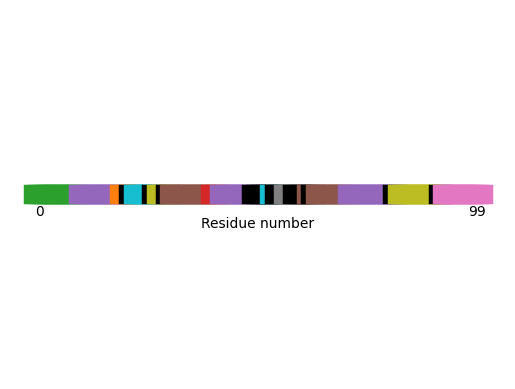

In [96]:
visualizations.plot_residue_line_plus_noise(residue_items, result_hdbscan_2_2.labels_)

In [97]:
from sklearn.cluster import AffinityPropagation

In [98]:
clustering_aff = AffinityPropagation(random_state=5, affinity="precomputed").fit(normed_similarity_matrix.astype(np.float64))
clustering_aff_1std = AffinityPropagation(random_state=5, affinity="precomputed").fit(normed_similarity_matrix_1std.astype(np.float64))
clustering_aff_2std = AffinityPropagation(random_state=5, affinity="precomputed").fit(normed_similarity_matrix_2std.astype(np.float64))

In [99]:
clustering.labels_

array([ 1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  0,  0, -1,  8,  8,  8,  8, -1,  7,  7, -1,  4,  4,  4,  4,
        4,  4,  4,  4,  4,  2,  2,  3,  3,  3,  3,  3,  3,  3, -1, -1, -1,
       -1,  8, -1, -1,  6,  6, -1, -1, -1,  4, -1,  4,  4,  4,  4,  4,  4,
        4,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3, -1,  7,  7,  7,  7,  7,
        7,  7,  7,  7, -1,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5])

In [100]:
clustering_aff_1std.labels_

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  1,  1,  1,
        2,  2,  2,  2,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  4,  4,  4,
        4,  4,  4,  5,  5,  5,  5,  5,  6,  6,  6,  6,  6,  6,  6,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8,
        8,  8,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10, 10,
       10, 10, 10, 10, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11])

In [101]:
clustering_aff_2std.labels_

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  1,  1,  1,
        2,  2,  2,  2,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  4,  4,  4,
        4,  4,  4,  5,  5,  5,  5,  5,  6,  6,  6,  6,  6,  6,  6,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8,
        8,  8,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10, 10,
       10, 10, 10, 10, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11])

In [102]:
res_hdbscan_2_1 = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan", min_cluster_size=2, min_samples=1)

0.0051


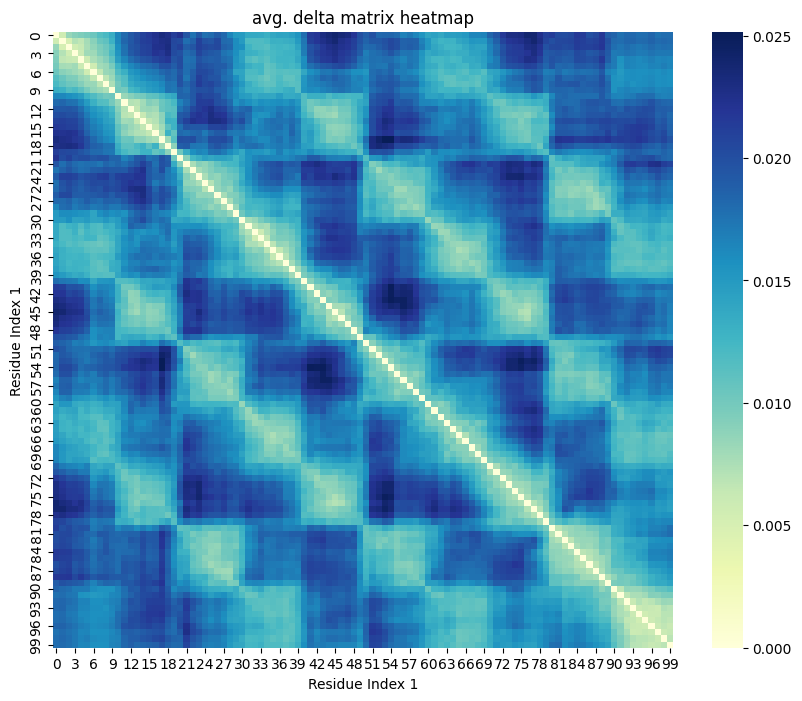

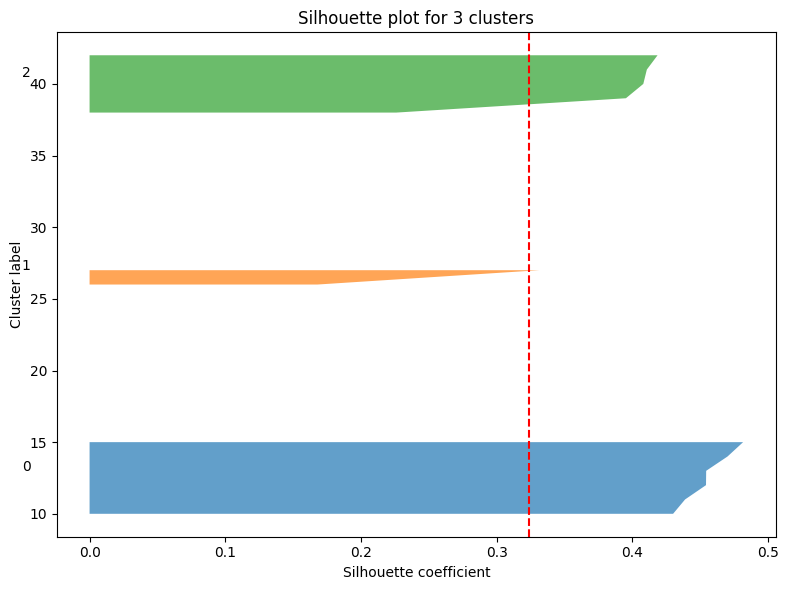

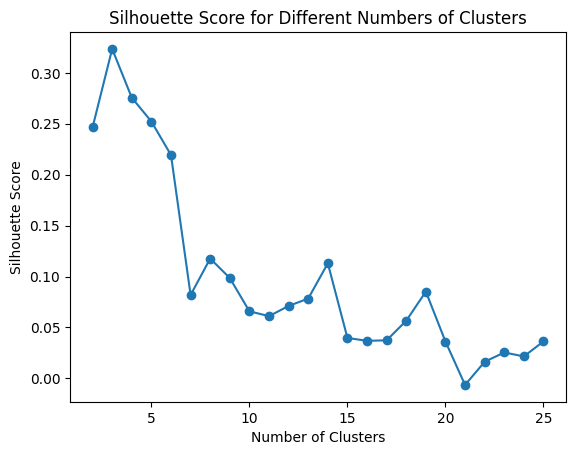

1.5264


In [103]:
spectral_opt_sil = distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix, cluster_count=None, silhouette = True)
spectral_opt_sil = list(spectral_opt_sil)


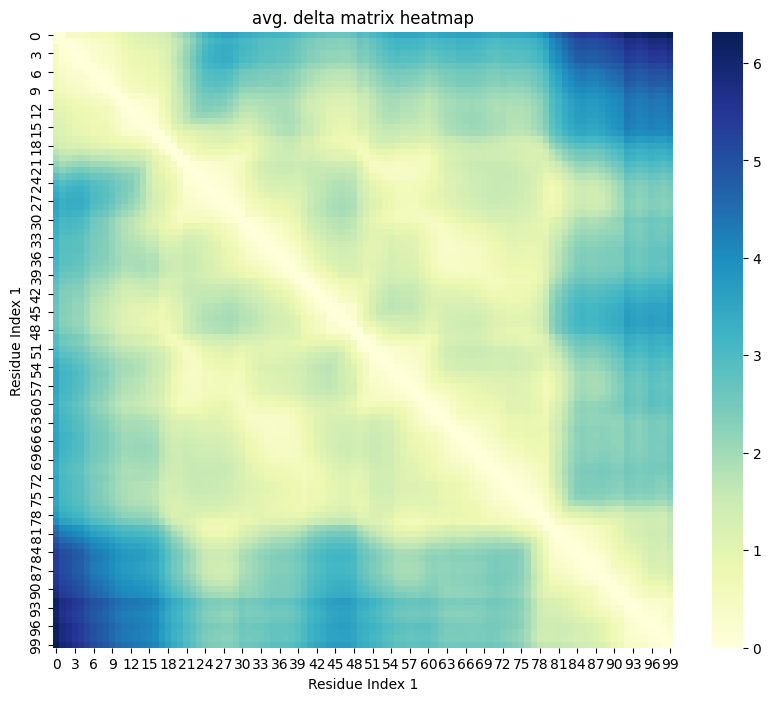

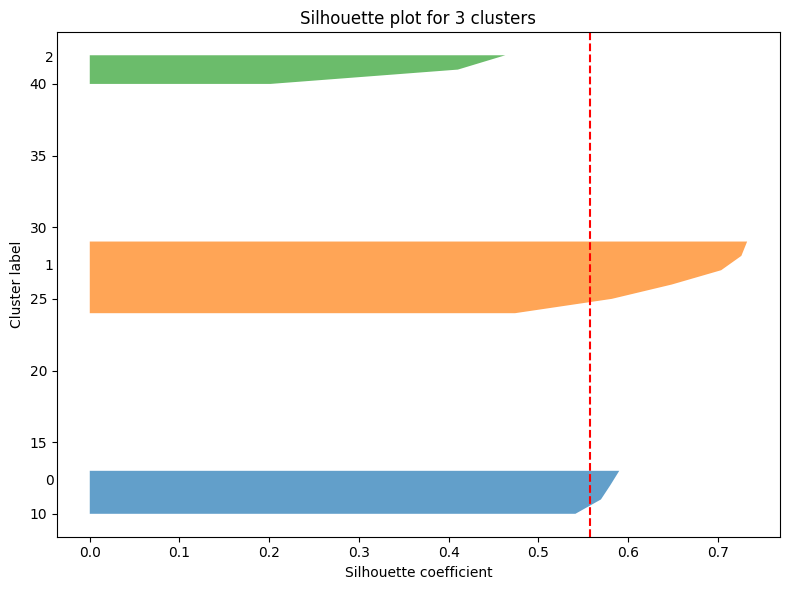

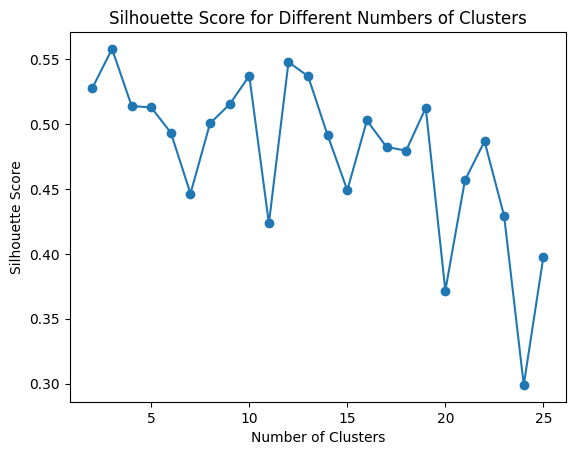

1.2601


In [104]:
spectral_opt_sil_1std = distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix_1std, cluster_count=None, silhouette = True)
spectral_opt_sil_1std = list(spectral_opt_sil_1std)

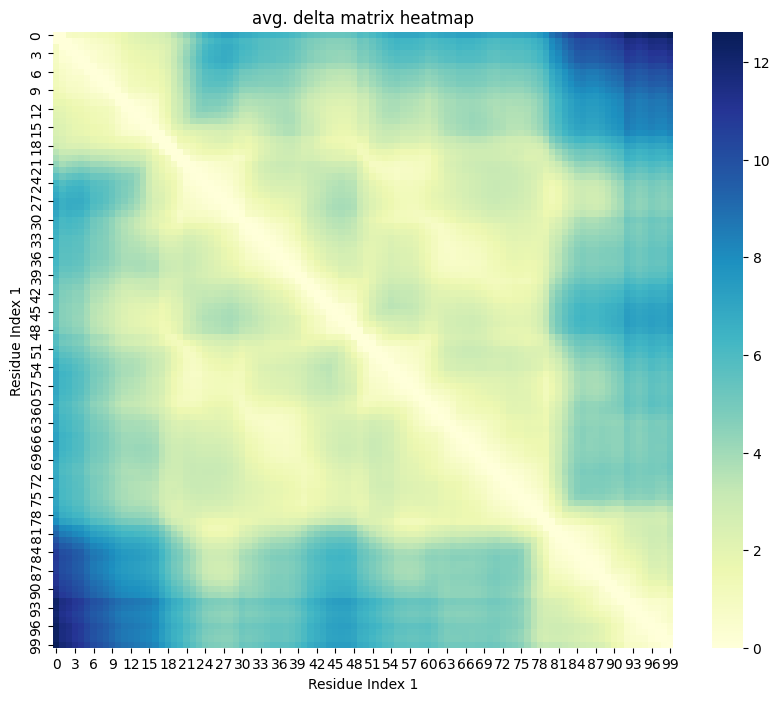

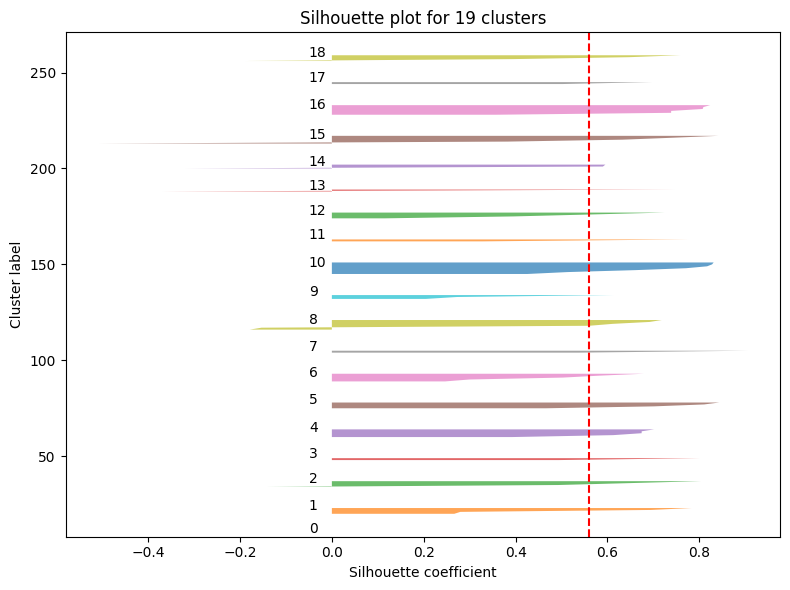

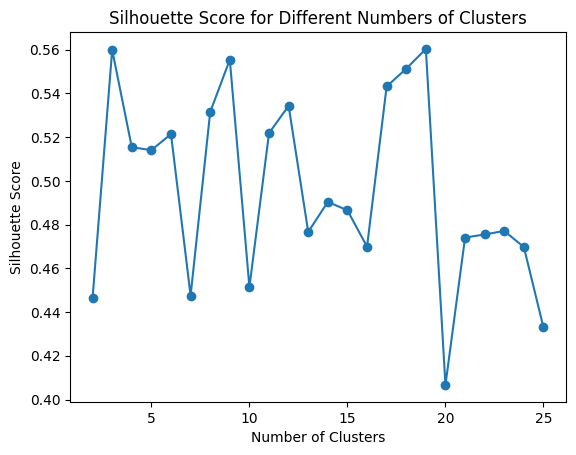

1.4739


In [105]:
spectral_opt_sil_2std = distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix_2std, cluster_count=None, silhouette = True)
spectral_opt_sil_2std = list(spectral_opt_sil_2std)

In [106]:
clustering_names = []
clustering_results = []

clustering_names.append("hdbscan, min_cluster:2, min_samples:1")
clustering_results.append(list(res_hdbscan_2_1[0]))
clustering_names.append("hdbscan, +2std, min_cluster:2, min_samples:1")
clustering_results.append(list(res_hdbscan_2std[0]))

clustering_names.append("hdbscan, min_cluster:2, min_samples:2")
clustering_results.append(list(result_hdbscan_2_2.labels_))
clustering_names.append("hdbscan, +2std, min_cluster:2, min_samples:2")
clustering_results.append(list(result_hdbscan_2_2_2std.labels_))
clustering_names.append("hdbscan, min_cluster:4, min_samples:2")
clustering_results.append(list(result_hdbscan_4_2.labels_))
clustering_names.append("hdbscan, +1std, min_cluster:4, min_samples:2")
clustering_results.append(list(result_hdbscan_4_2_1std.labels_))



clustering_names.append("spectral,  clusters:6")
clustering_results.append(list(result_spectral_6.labels_))
clustering_names.append("spectral,  clusters:3")
clustering_results.append(list(result_spectral_3.labels_))
clustering_names.append("spectral,  clusters:4")
clustering_results.append(list(result_spectral_4.labels_))

clustering_names.append("affinity prop")
clustering_results.append(list(clustering_aff.labels_))
clustering_names.append("affinity prop, +1std")
clustering_results.append(list(clustering_aff_1std.labels_))
clustering_names.append("affinity prop, +2std")
clustering_results.append(list(clustering_aff_2std.labels_))

clustering_names.append("spectra, opt.silh.")
clustering_results.append(list(spectral_opt_sil))
clustering_names.append("spectra, opt.silh., +1std")
clustering_results.append(list(spectral_opt_sil_1std))
clustering_names.append("spectra, opt.silh., +2std")
clustering_results.append(list(spectral_opt_sil_2std))





In [107]:
import numpy as np
from scipy.optimize import linear_sum_assignment
from sklearn.metrics import confusion_matrix

def evaluate_clustering_nr_wrong_elements(true_labels, predicted_labels):

    cm = confusion_matrix(true_labels, predicted_labels)
    
    # Hungarian / Munkres algorithm
    row_ind, col_ind = linear_sum_assignment(-cm)
    
    correctly_clustered = cm[row_ind, col_ind].sum()
    
    total_items = len(true_labels)
    wrongly_clustered = total_items - correctly_clustered
    
    return wrongly_clustered

In [108]:
traj_array = np.array(trajectories)[:,:,:-1]

In [109]:
flattened_array = traj_array.reshape(traj_array.shape[0], -1)

In [110]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat = clustering.fit(flattened_array.astype(np.float64))


In [111]:
result_hdbscan_2_2_flat.labels_


array([-1,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  6,  6,  6,  6,  6,  6,
        6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6, -1, -1,  3,  3,  3,
        3,  3,  3,  3,  3,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,
        4,  4,  4,  4,  4,  4,  4,  4, -1,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2, -1])

In [112]:
clustering = SpectralClustering(n_clusters=3)
result_spectral_3_flat = clustering.fit(flattened_array)

In [113]:
result_spectral_3_flat.labels_

array([0, 1, 2, 0, 0, 1, 1, 1, 2, 1, 1, 2, 0, 1, 0, 1, 0, 0, 0, 1, 2, 0,
       2, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 2, 0, 1, 1, 1, 0, 2, 2, 1, 0, 1,
       0, 1, 1, 1, 0, 0, 2, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0,
       2, 0, 2, 1, 1, 2, 0, 0, 1, 0, 1, 0, 2, 2, 1, 1, 1, 1, 1, 0, 2, 2,
       1, 1, 1, 1, 0, 2, 1, 0, 2, 2, 0, 1], dtype=int32)

In [114]:
#vels_to_cluster = process_data.simulation_to_array_velocities(particles_from_sim)

In [115]:
def compute_velocities(points, delta_t=1):

    velocities = []
    
    for point_series in points:
        point_velocities = []
        for i in range(1, len(point_series)):
            velocity = [(point_series[i][j] - point_series[i-1][j]) / delta_t for j in range(3)]
            point_velocities.append(velocity)
        
        #let's assume starting velocity is 0
        point_velocities.insert(0, [0.0, 0.0, 0.0])
        velocities.append(point_velocities)
    
    return velocities

    
try:
    vels_to_cluster = process_data.simulation_to_array_velocities(particles_from_sim)
    traj_array_vel = np.array(vels_to_cluster)[:,:,:-1]
    flattened_array_vel = traj_array_vel.reshape(traj_array_vel.shape[0], -1)

except:
    print("no simulation data with velocities")
    traj_array_vel = compute_velocities(traj_array)
    traj_array_vel = np.array(traj_array_vel)
    flattened_array_vel =  traj_array_vel.reshape(traj_array_vel.shape[0], -1)

In [116]:
traj_array = np.array(trajectories)[:,:,:-1]
flattened_array = traj_array.reshape(traj_array.shape[0], -1)

In [117]:
#traj_array_vel = np.array(vels_to_cluster)[:,:,:-1]
#flattened_array_vel = traj_array_vel.reshape(traj_array_vel.shape[0], -1)

In [118]:
clustering = SpectralClustering(n_clusters=3)
result_spectral_3_flat = clustering.fit(flattened_array)
result_spectral_3_flat.labels_

array([0, 1, 1, 0, 1, 0, 0, 2, 0, 0, 2, 1, 1, 1, 1, 2, 0, 0, 2, 1, 0, 0,
       1, 1, 2, 0, 1, 2, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1,
       1, 0, 1, 1, 1, 2, 0, 2, 2, 1, 1, 1, 1, 2, 1, 1, 0, 1, 0, 2, 0, 2,
       1, 1, 0, 0, 2, 1, 2, 1, 0, 1, 0, 0, 2, 0, 2, 0, 1, 1, 1, 1, 0, 2,
       1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 2, 1], dtype=int32)

In [119]:
clustering = SpectralClustering(n_clusters=4)
result_spectral_4_flat = clustering.fit(flattened_array)
result_spectral_4_flat.labels_

array([2, 0, 3, 3, 1, 2, 1, 1, 0, 0, 0, 2, 0, 0, 2, 1, 0, 2, 1, 1, 2, 2,
       0, 2, 2, 2, 0, 2, 2, 2, 1, 2, 1, 0, 3, 1, 1, 1, 2, 3, 2, 3, 2, 2,
       1, 0, 2, 2, 2, 2, 1, 0, 0, 0, 1, 3, 1, 1, 0, 1, 2, 3, 0, 2, 2, 2,
       2, 2, 1, 1, 3, 1, 3, 0, 2, 2, 0, 2, 1, 1, 0, 2, 3, 1, 2, 2, 2, 3,
       3, 1, 2, 2, 0, 2, 2, 1, 1, 2, 2, 2], dtype=int32)

In [120]:
clustering = SpectralClustering(n_clusters=3)
result_spectral_3_flat_vel = clustering.fit(flattened_array_vel)
result_spectral_3_flat_vel.labels_

array([0, 0, 1, 0, 2, 1, 1, 2, 1, 1, 2, 1, 0, 1, 1, 1, 1, 0, 0, 0, 2, 2,
       0, 0, 1, 1, 2, 0, 1, 1, 2, 1, 0, 2, 1, 1, 2, 2, 0, 0, 0, 2, 1, 0,
       2, 2, 0, 2, 1, 1, 1, 2, 1, 2, 0, 0, 0, 0, 1, 2, 1, 1, 2, 2, 2, 0,
       2, 1, 2, 0, 1, 2, 2, 2, 2, 0, 0, 0, 2, 0, 1, 2, 0, 1, 1, 0, 1, 2,
       0, 2, 1, 0, 0, 2, 2, 0, 1, 0, 0, 1], dtype=int32)

In [121]:
clustering = SpectralClustering(n_clusters=4)
result_spectral_4_flat_vel = clustering.fit(flattened_array_vel)
result_spectral_4_flat_vel.labels_

array([2, 1, 2, 1, 0, 3, 0, 0, 2, 1, 0, 1, 3, 2, 1, 0, 1, 0, 1, 1, 1, 1,
       0, 0, 1, 0, 0, 2, 0, 0, 1, 1, 0, 2, 2, 1, 0, 0, 3, 0, 1, 3, 0, 0,
       3, 3, 0, 2, 3, 3, 0, 0, 0, 3, 3, 1, 2, 3, 3, 1, 3, 0, 3, 1, 3, 3,
       3, 0, 0, 0, 2, 0, 0, 0, 3, 0, 2, 0, 1, 1, 0, 0, 1, 1, 1, 1, 2, 0,
       0, 3, 3, 3, 1, 0, 1, 0, 0, 0, 0, 2], dtype=int32)

In [122]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat = clustering.fit(flattened_array.astype(np.float64))
result_hdbscan_2_2_flat.labels_

array([-1,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  6,  6,  6,  6,  6,  6,
        6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6, -1, -1,  3,  3,  3,
        3,  3,  3,  3,  3,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,
        4,  4,  4,  4,  4,  4,  4,  4, -1,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2, -1])

In [123]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=1) 


result_hdbscan_2_1_flat_vel = clustering.fit(flattened_array_vel.astype(np.float64))
result_hdbscan_2_1_flat_vel.labels_

array([3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 4, 8, 8, 8, 8, 8, 8, 9, 7, 5, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 8, 8, 8, 8, 8,
       8, 9, 7, 5, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6])

In [124]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat_vel = clustering.fit(flattened_array_vel.astype(np.float64))
result_hdbscan_2_2_flat_vel.labels_

array([ 2,  2,  2,  2,  2,  2,  2,  2,  2, -1,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1, -1,  4,  4,  4,
        4,  4,  4,  4,  4, -1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  3, -1,  4,  4,  4,  4,  4, -1,
       -1, -1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  3,  5,  5,  5,  5,  5,  5,  5,  5,  5])

In [125]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat = clustering.fit(flattened_array.astype(np.float64))
result_hdbscan_2_2_flat.labels_

clustering_names.append("hdbscan, flattened positions, 2, 2")
clustering_results.append(list(result_hdbscan_2_2_flat.labels_))

In [126]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat_vel = clustering.fit(flattened_array_vel.astype(np.float64))
result_hdbscan_2_2_flat_vel.labels_

clustering_names.append("hdbscan, flattened velocities, 2, 2")
clustering_results.append(list(result_hdbscan_2_2_flat_vel.labels_))

In [127]:

clustering_names.append("ground truth")
clustering_results.append(list(true_labels))

In [128]:
result_hdbscan_2_2.labels_

array([ 1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  0,  0, -1,  8,  8,  8,  8, -1,  7,  7, -1,  4,  4,  4,  4,
        4,  4,  4,  4,  4,  2,  2,  3,  3,  3,  3,  3,  3,  3, -1, -1, -1,
       -1,  8, -1, -1,  6,  6, -1, -1, -1,  4, -1,  4,  4,  4,  4,  4,  4,
        4,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3, -1,  7,  7,  7,  7,  7,
        7,  7,  7,  7, -1,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5])

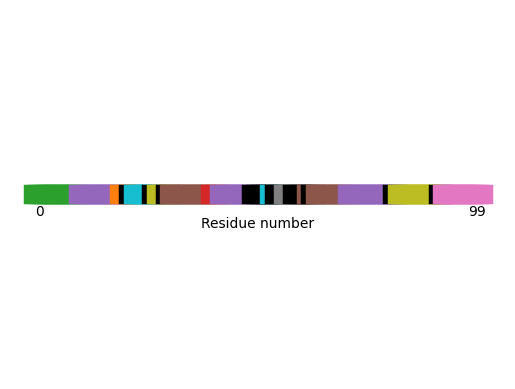

In [129]:
visualizations.plot_residue_line_plus_noise(residue_items, result_hdbscan_2_2.labels_)

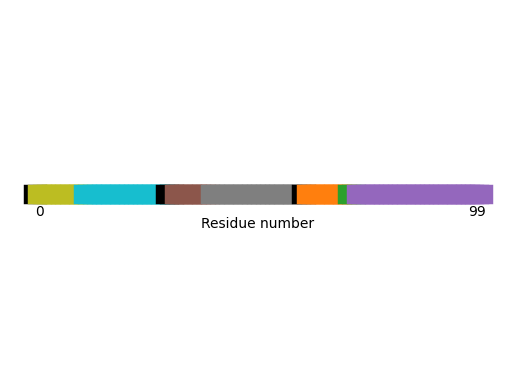

In [130]:
visualizations.plot_residue_line_plus_noise(residue_items, result_hdbscan_2_2_flat.labels_)

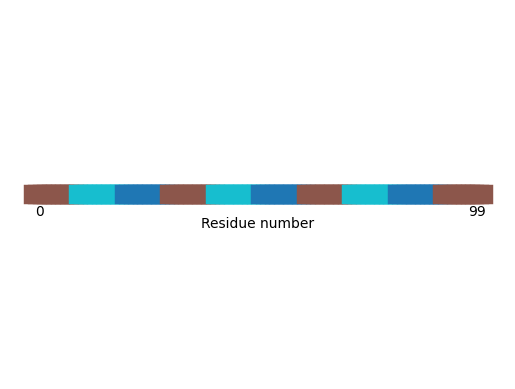

In [131]:
visualizations.plot_residue_line_plus_noise(residue_items, result_spectral_3.labels_)

In [132]:
import sklearn 
def get_clustering_similarity_true(true_clustering, clusterings, sim_function = sklearn.metrics.adjusted_rand_score):
    sim_results = []
    for i in range(len(clusterings)):
        sim_result = sim_function(true_clustering, clusterings[i])
        sim_results.append(sim_result)
    return sim_results

def get_clustering_similarity_true_trajectories(true_clusterings, clusterings, sim_function = sklearn.metrics.adjusted_rand_score):
    sim_results = []
    for i in range(len(clusterings)):
        sim_result = sim_function(true_clusterings[i], clusterings[i])
        sim_results.append(sim_result)
    return sim_result



Text(0.5, 1.0, 'adjusted rand score')

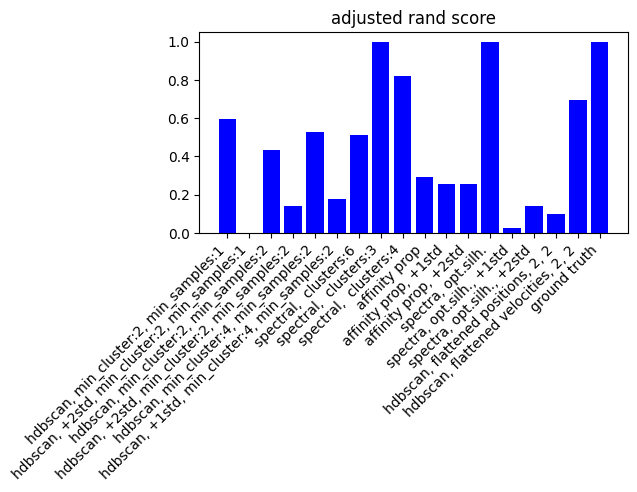

In [133]:
sim_scores = get_clustering_similarity_true(true_labels, clustering_results)
plt.bar(clustering_names, sim_scores, color='blue')
plt.xticks(rotation=45, ha='right')  

plt.tight_layout()

plt.title("adjusted rand score")

Text(0.5, 1.0, 'nr. of wrong elements')

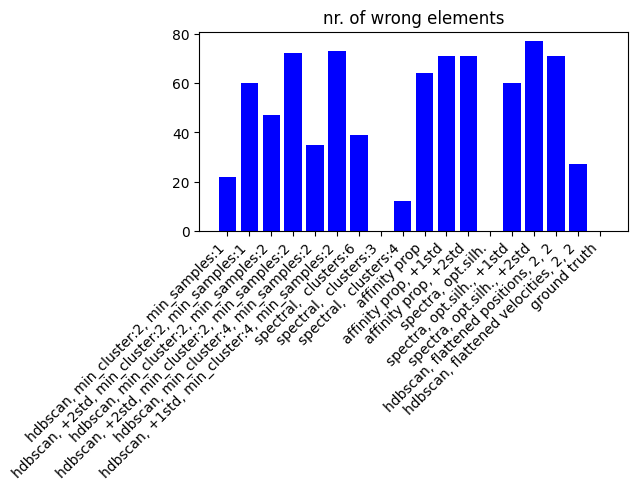

In [134]:
sim_scores = get_clustering_similarity_true(true_labels, clustering_results, evaluate_clustering_nr_wrong_elements)
plt.bar(clustering_names, sim_scores, color='blue')
plt.xticks(rotation=45, ha='right')  

plt.tight_layout()

plt.title("nr. of wrong elements")

Text(0.5, 1.0, 'NMI')

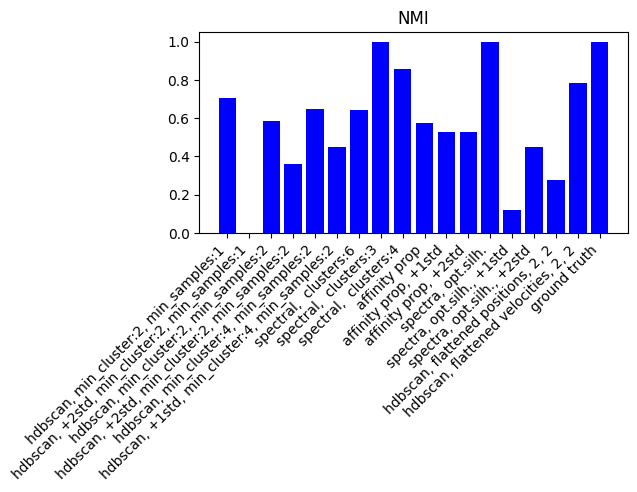

In [135]:
sim_scores = get_clustering_similarity_true(true_labels, clustering_results, sklearn.metrics.normalized_mutual_info_score)
plt.bar(clustering_names, sim_scores, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("NMI")

Text(0.5, 1.0, 'number of points class. as noise')

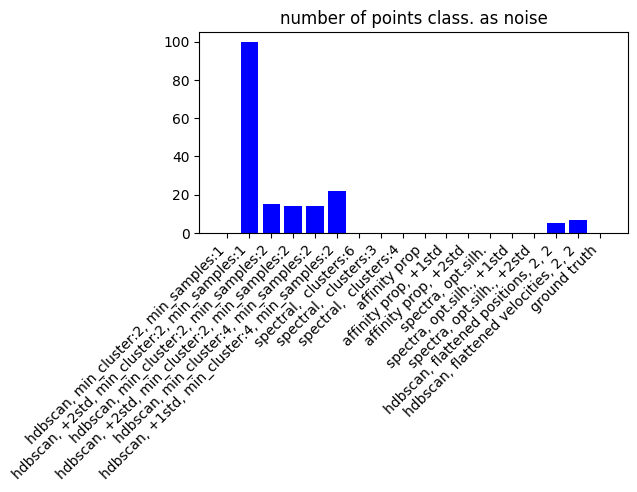

In [136]:
noise_elements = []
noise_int = -1
for res in clustering_results:
    noise_el = len(np.where(np.array(res)==noise_int)[0])
    noise_elements.append(noise_el)

plt.bar(clustering_names, noise_elements, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("number of points class. as noise")

Text(0.5, 1.0, 'number of clusters')

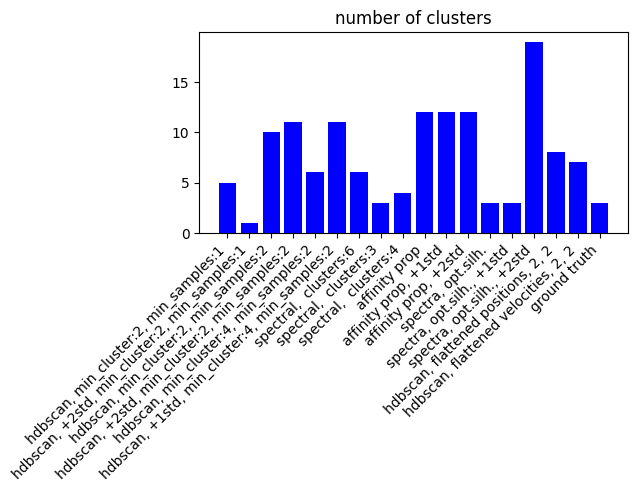

In [137]:

plt.bar(clustering_names, [len(np.unique(x)) for x in clustering_results], color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("number of clusters")

In [138]:
#Q calculations

clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


Text(0.5, 1.0, 'Q_max from distance matrices, full, thinning=500')

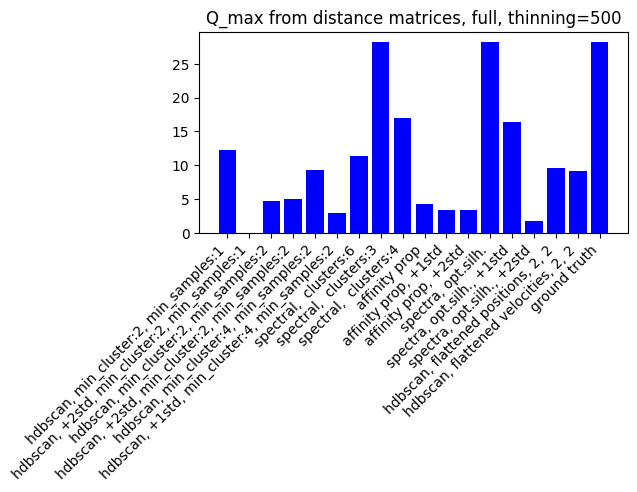

In [139]:
Qs = []
for res in clustering_results:

    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=True, thinning_factor=500, only_adjacent=False, reference_frame=None, return_raw=False)
    Qs.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qs, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_max from distance matrices, full, thinning=500")

In [140]:
'''
Qs = []
for res in clustering_results:

    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=True, thinning_factor=None, only_adjacent=False, reference_frame=None, return_raw=False)
    Qs.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qs, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_max from distance matrices, full")
'''

'\nQs = []\nfor res in clustering_results:\n\n    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=True, thinning_factor=None, only_adjacent=False, reference_frame=None, return_raw=False)\n    Qs.append(new_dist_Q_max_value)\n\nplt.bar(clustering_names, Qs, color=\'blue\')\nplt.xticks(rotation=45, ha=\'right\') \n\nplt.tight_layout()\n\nplt.title("Q_max from distance matrices, full")\n'

clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


Text(0.5, 1.0, 'Q_mean from distance matrices, full, thinning 500')

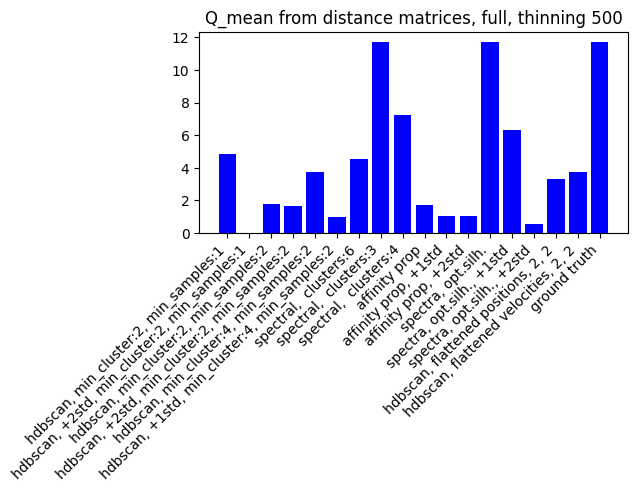

In [141]:
Qsf3= []
for res in clustering_results:

    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=False, thinning_factor=500, only_adjacent=False, reference_frame=None, return_raw=False)
    Qsf3.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qsf3, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_mean from distance matrices, full, thinning 500")

In [142]:
'''
Qsf3= []
for res in clustering_results:

    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=False, thinning_factor=None, only_adjacent=False, reference_frame=None, return_raw=False)
    Qsf3.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qsf3, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_mean from distance matrices, full")
'''

'\nQsf3= []\nfor res in clustering_results:\n\n    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=False, thinning_factor=None, only_adjacent=False, reference_frame=None, return_raw=False)\n    Qsf3.append(new_dist_Q_max_value)\n\nplt.bar(clustering_names, Qsf3, color=\'blue\')\nplt.xticks(rotation=45, ha=\'right\') \n\nplt.tight_layout()\n\nplt.title("Q_mean from distance matrices, full")\n'

clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


Text(0.5, 1.0, 'Q_max from positions, Kabsch superimposition, full, thinning=100')

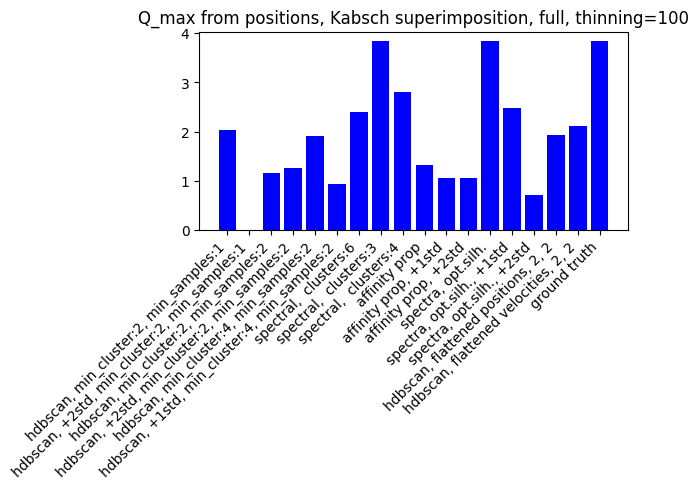

In [143]:

Qs = []

for res in clustering_results:


    new_dist_Q_max_value, _ = get_Q_for_clustering_positions(traj_array, np.array(res), None, use_max=True, apply_superimposition = "kabsch", thinning_factor=100, only_adjacent=False, reference_frame=None, return_raw=False)
    Qs.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qs, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_max from positions, Kabsch superimposition, full, thinning=100")

clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


Text(0.5, 1.0, 'Q_mean from positions, Kabsch superimposition, full, thinning 50')

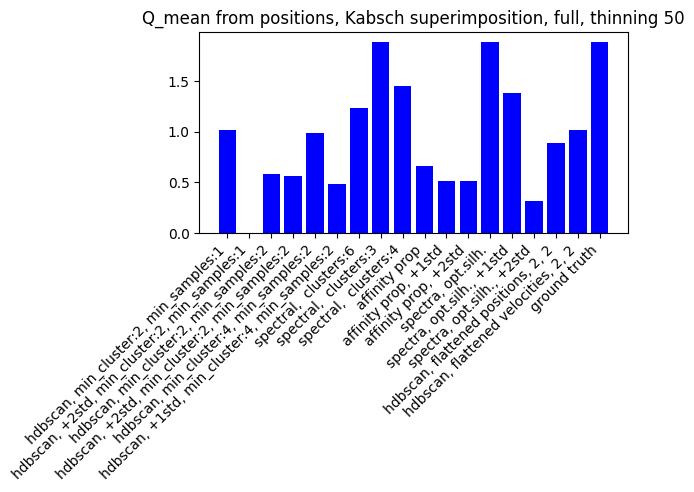

In [144]:
Qs = []

for res in clustering_results:


    new_dist_Q_max_value, _ = get_Q_for_clustering_positions(traj_array, np.array(res), None, use_max=False, apply_superimposition = "kabsch", thinning_factor=50, only_adjacent=False, reference_frame=None, return_raw=False)
    Qs.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qs, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_mean from positions, Kabsch superimposition, full, thinning 50")

In [145]:
#q computation fuer verschiedene cluster

In [146]:
import compare_clusterings
import numpy as np
from itertools import combinations

In [147]:
from compare_clusterings import *
from manipulate_trajectory import thin_trajectory

In [148]:
clustering_results

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 [-1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
 

In [149]:
clustering_names

['hdbscan, min_cluster:2, min_samples:1',
 'hdbscan, +2std, min_cluster:2, min_samples:1',
 'hdbscan, min_cluster:2, min_samples:2',
 'hdbscan, +2std, min_cluster:2, min_samples:2',
 'hdbscan, min_cluster:4, min_samples:2',
 'hdbscan, +1std, min_cluster:4, min_samples:2',
 'spectral,  clusters:6',
 'spectral,  clusters:3',
 'spectral,  clusters:4',
 'affinity prop',
 'affinity prop, +1std',
 'affinity prop, +2std',
 'spectra, opt.silh.',
 'spectra, opt.silh., +1std',
 'spectra, opt.silh., +2std',
 'hdbscan, flattened positions, 2, 2',
 'hdbscan, flattened velocities, 2, 2',
 'ground truth']

clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


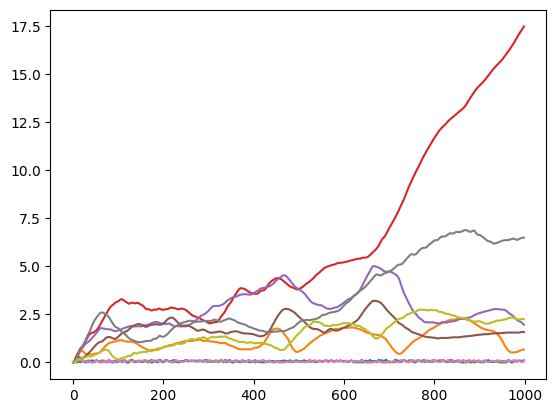

In [150]:
current_clustering = np.array(clustering_results[clustering_names.index('hdbscan, min_cluster:2, min_samples:2')])
qtraj_nosup = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=False, apply_superimposition = None, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_center = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = None, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_kabsch = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = "kabsch", thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_procrustes = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = "procrustes", thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_dist = get_Q_for_clustering_extended(dist_matrices, current_clustering, None, use_max=True, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_dist_adj = get_Q_for_clustering_extended(dist_matrices, current_clustering, None, use_max=True, thinning_factor=None, only_adjacent=True,  return_raw=True)

for qt in qtraj_dist:
    plt.plot(qt)

In [151]:
current_clustering = np.array(clustering_results[clustering_names.index('ground truth')])

In [152]:
qtraj_nosup = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=False, apply_superimposition = None, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_center = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = None, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_kabsch = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = "kabsch", thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_procrustes = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = "procrustes", thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_dist = get_Q_for_clustering_extended(dist_matrices, current_clustering, None, use_max=True, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_dist_adj = get_Q_for_clustering_extended(dist_matrices, current_clustering, None, use_max=True, thinning_factor=None, only_adjacent=True,  return_raw=True)



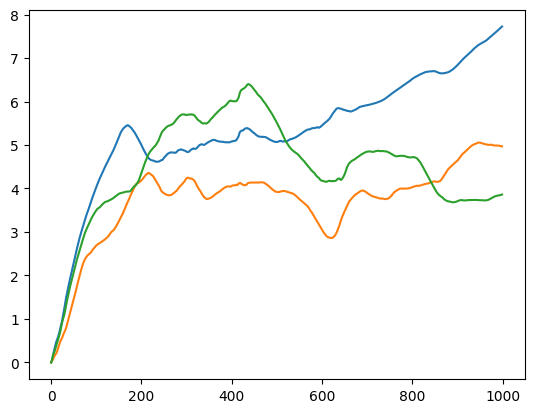

In [153]:
for qt in qtraj_nosup:
    plt.plot(qt)

Text(0.5, 1.0, 'RMSD from positions, centered, reference_frame=0')

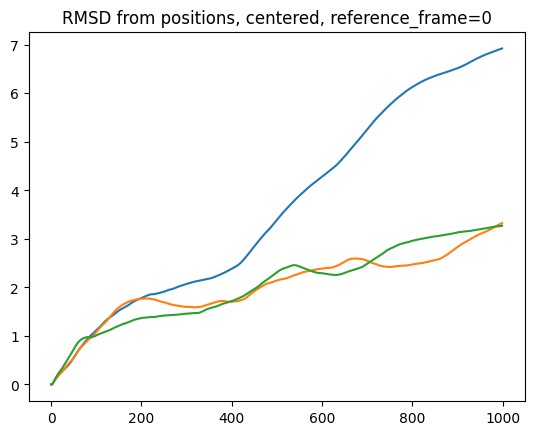

In [154]:
%matplotlib inline
for qt in qtraj_center:
    plt.plot(qt)
plt.title("RMSD from positions, centered, reference_frame=0")

Text(0.5, 1.0, 'RMSD from positions, Kabsch, reference_frame=0')

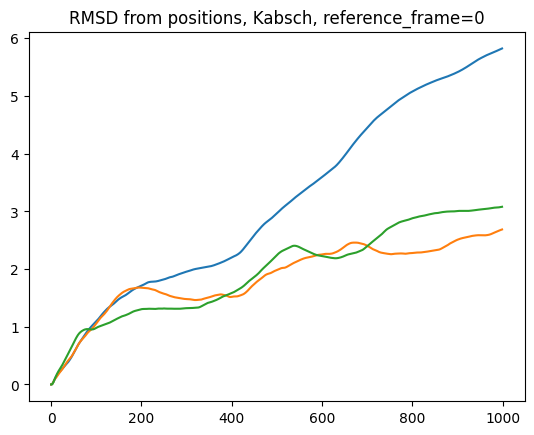

In [155]:
for qt in qtraj_kabsch:
    plt.plot(qt)
plt.title("RMSD from positions, Kabsch, reference_frame=0")

Text(0.5, 1.0, 'RMSD from positions, Procrustes, reference_frame=0')

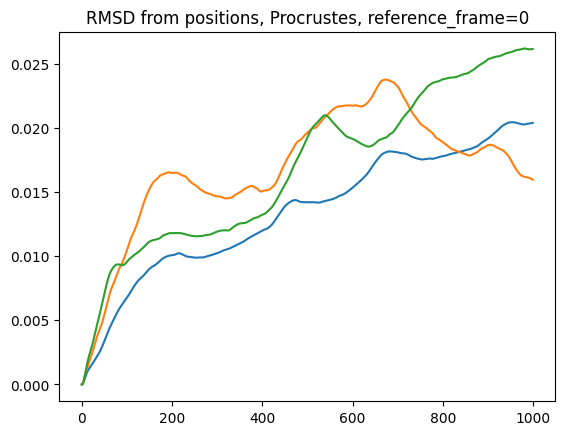

In [156]:
for qt in qtraj_procrustes:
    plt.plot(qt)
plt.title("RMSD from positions, Procrustes, reference_frame=0")

Text(0.5, 1.0, 'RMSD from distance matrices, reference_frame=0')

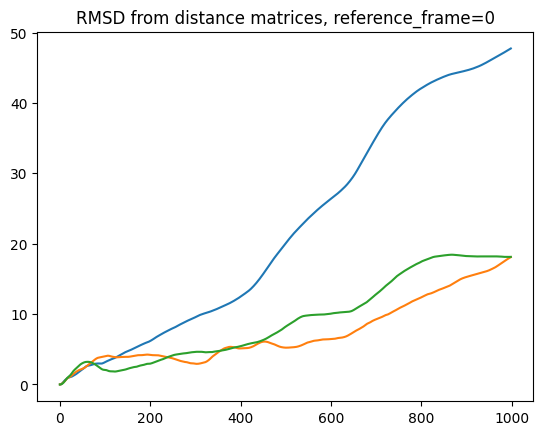

In [157]:
for qt in qtraj_dist:
    plt.plot(qt)
plt.title("RMSD from distance matrices, reference_frame=0")

Text(0.5, 1.0, 'RMSD from distance matrices, adjacent frames')

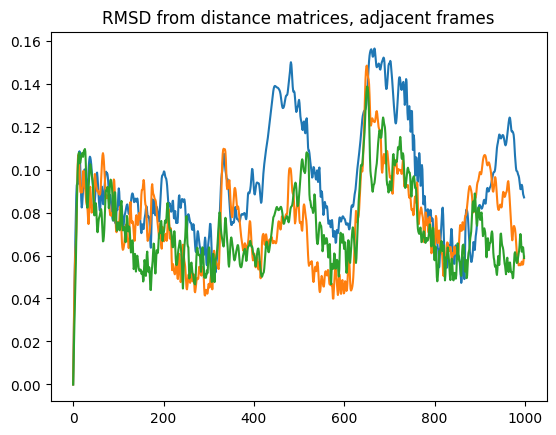

In [158]:
for qt in qtraj_dist_adj:
    plt.plot(qt)
plt.title("RMSD from distance matrices, adjacent frames")

In [159]:
clustering_results

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 [-1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
 

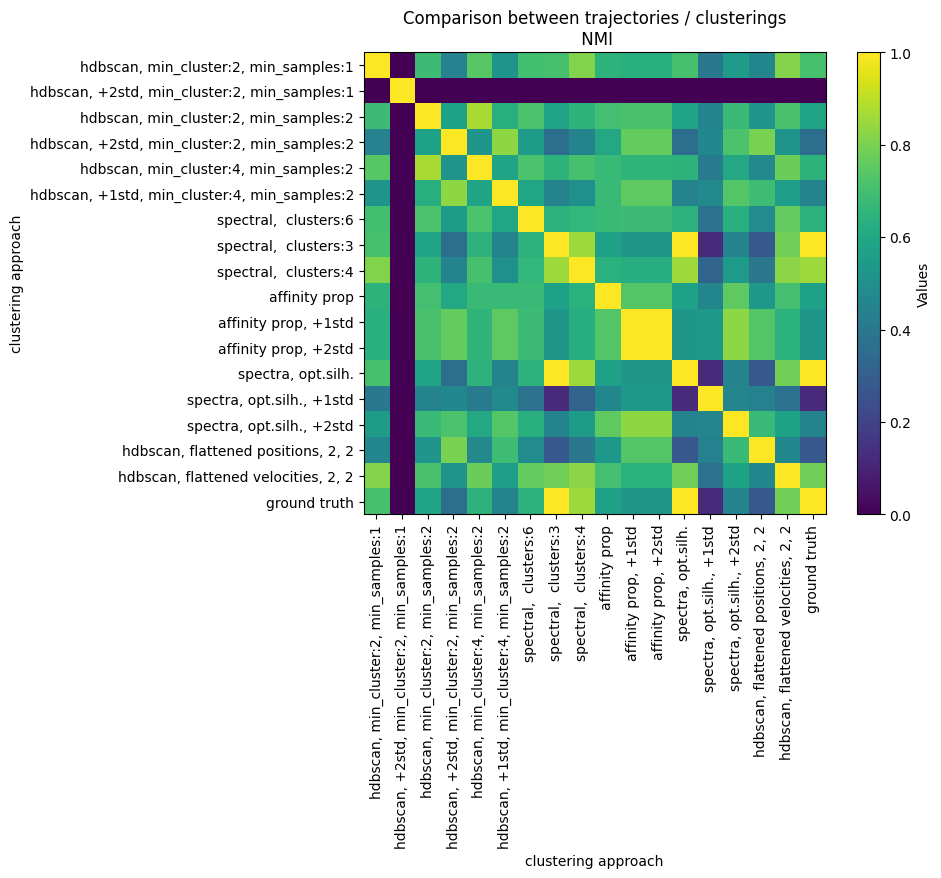

[[0, 0, 1.0],
 [0, 1, 0.0],
 [0, 2, 0.683788747444454],
 [0, 3, 0.4431677355201521],
 [0, 4, 0.7395412177099613],
 [0, 5, 0.5161921101402028],
 [0, 6, 0.695815847489241],
 [0, 7, 0.7075212262588104],
 [0, 8, 0.8106219870706124],
 [0, 9, 0.6451972841941732],
 [0, 10, 0.6328542407438945],
 [0, 11, 0.6328542407438945],
 [0, 12, 0.7075212262588104],
 [0, 13, 0.3997437953583267],
 [0, 14, 0.5517090139824588],
 [0, 15, 0.4585605374225523],
 [0, 16, 0.8143330234356615],
 [0, 17, 0.7075212262588104],
 [1, 0, 0.0],
 [1, 1, 1.0],
 [1, 2, 0.0],
 [1, 3, 0.0],
 [1, 4, 0.0],
 [1, 5, 0.0],
 [1, 6, 0.0],
 [1, 7, 0.0],
 [1, 8, 0.0],
 [1, 9, 0.0],
 [1, 10, 0.0],
 [1, 11, 0.0],
 [1, 12, 0.0],
 [1, 13, 0.0],
 [1, 14, 0.0],
 [1, 15, 0.0],
 [1, 16, 0.0],
 [1, 17, 0.0],
 [2, 0, 0.683788747444454],
 [2, 1, 0.0],
 [2, 2, 1.0],
 [2, 3, 0.5710663074108175],
 [2, 4, 0.8694234301918554],
 [2, 5, 0.6274540551214425],
 [2, 6, 0.7159476667631381],
 [2, 7, 0.5842440736353649],
 [2, 8, 0.6473620446352852],
 [2, 9, 0.70

In [160]:
%matplotlib inline
get_trajectory_heatmap(np.array(clustering_results), np.array(clustering_results), nmi = True, create_heatmap = True, title = "Comparison between trajectories / clusterings", names=clustering_names, heatmap_label="clustering approach")

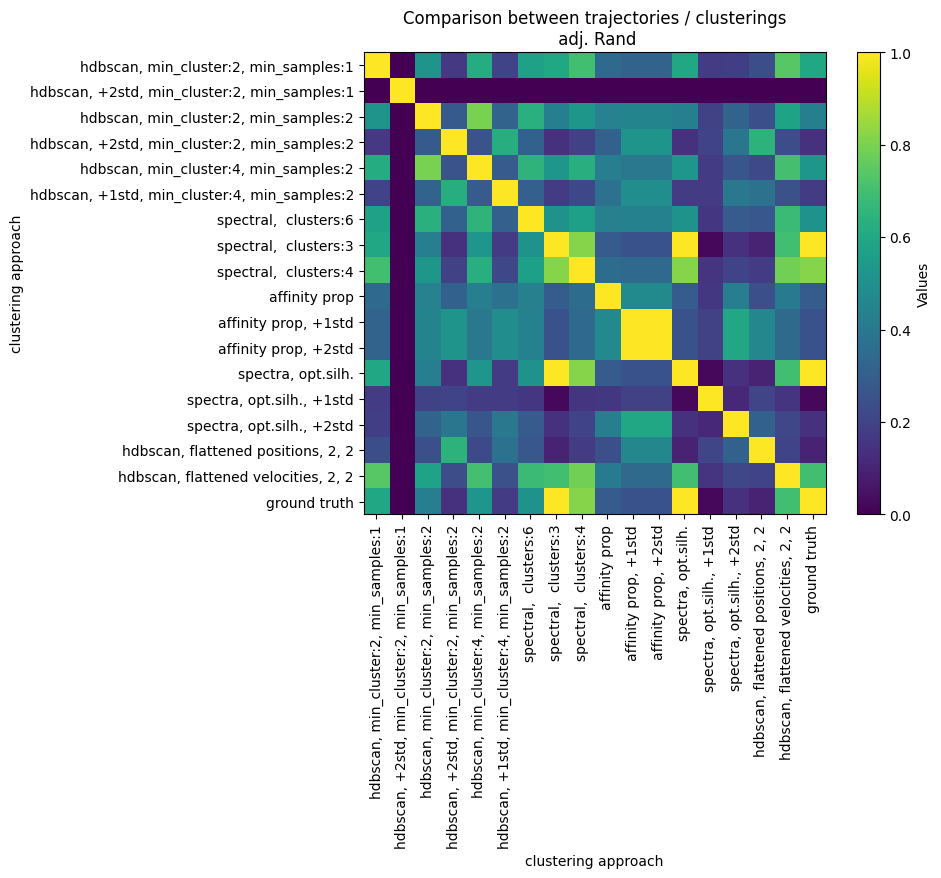

[[0, 0, 1.0],
 [0, 1, 0.0],
 [0, 2, 0.5193600255528618],
 [0, 3, 0.16558065807191907],
 [0, 4, 0.619588038423187],
 [0, 5, 0.20253460491524924],
 [0, 6, 0.5714479556145218],
 [0, 7, 0.5952080706179067],
 [0, 8, 0.699173651455349],
 [0, 9, 0.34169538302513747],
 [0, 10, 0.3197018430591719],
 [0, 11, 0.3197018430591719],
 [0, 12, 0.5952080706179067],
 [0, 13, 0.1748763681842439],
 [0, 14, 0.18736302394604257],
 [0, 15, 0.23863990102932348],
 [0, 16, 0.7414975291442116],
 [0, 17, 0.5952080706179067],
 [1, 0, 0.0],
 [1, 1, 1.0],
 [1, 2, 0.0],
 [1, 3, 0.0],
 [1, 4, 0.0],
 [1, 5, 0.0],
 [1, 6, 0.0],
 [1, 7, 0.0],
 [1, 8, 0.0],
 [1, 9, 0.0],
 [1, 10, 0.0],
 [1, 11, 0.0],
 [1, 12, 0.0],
 [1, 13, 0.0],
 [1, 14, 0.0],
 [1, 15, 0.0],
 [1, 16, 0.0],
 [1, 17, 0.0],
 [2, 0, 0.5193600255528618],
 [2, 1, 0.0],
 [2, 2, 1.0],
 [2, 3, 0.28138425525997834],
 [2, 4, 0.800322710770472],
 [2, 5, 0.3187428117416527],
 [2, 6, 0.6348646645162583],
 [2, 7, 0.43214663376806484],
 [2, 8, 0.5295175768450959],
 [2, 

In [161]:
get_trajectory_heatmap(np.array(clustering_results), np.array(clustering_results), nmi = False, create_heatmap = True, title = "Comparison between trajectories / clusterings", names=clustering_names, heatmap_label="clustering approach")

In [162]:
clustering_results

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 [-1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
 

In [163]:
clustering_names

['hdbscan, min_cluster:2, min_samples:1',
 'hdbscan, +2std, min_cluster:2, min_samples:1',
 'hdbscan, min_cluster:2, min_samples:2',
 'hdbscan, +2std, min_cluster:2, min_samples:2',
 'hdbscan, min_cluster:4, min_samples:2',
 'hdbscan, +1std, min_cluster:4, min_samples:2',
 'spectral,  clusters:6',
 'spectral,  clusters:3',
 'spectral,  clusters:4',
 'affinity prop',
 'affinity prop, +1std',
 'affinity prop, +2std',
 'spectra, opt.silh.',
 'spectra, opt.silh., +1std',
 'spectra, opt.silh., +2std',
 'hdbscan, flattened positions, 2, 2',
 'hdbscan, flattened velocities, 2, 2',
 'ground truth']

In [164]:

new_plot_data = process_data.prepare_clustered_results_for_plotly(trajectories, np.array(clustering_results[clustering_names.index('hdbscan, min_cluster:2, min_samples:2')]))

In [165]:
%matplotlib notebook

ab_hsv = plot_functions.plot_traj_labels_plt(new_plot_data, save_video=False, interval = 10, color_map='Spectral', noise_label = -1, title = sim_command + "\n hdbscan, min_cluster:2, min_samples:2", plt_fig_size=(10,7.5))

<IPython.core.display.Javascript object>

In [166]:
from IPython.display import HTML
HTML(ab_hsv.to_html5_video())